# Exploratory Training Data Analysis
- Identifying features > 25% missing to remove
- Identifying extremely correlating features to remove
- Plotting distributions of features
- Plotting selected features by BorutaShap (correlation, covariance, distribution, mutual information, pairwise plots)
- Pairwise-dependence plots of selected features by BorutaShap and their feature-feature interactions.
- Visualization of unsupervised learning (training data groupings in hierarchical clustering and silhoutte plots)

In [2]:
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import plotly.io as pio
from pdpbox import get_dataset, info_plots, pdp

%matplotlib inline
%config InlineBackend.figure_format ='retina'

pio.renderers.default = "notebook"
import plotly.figure_factory as ff
import plotly.offline as py

py.init_notebook_mode(connected=True)
import matplotlib.pyplot as plt
import missingno as msno
import numpy
import plotly.graph_objs as go
import plotly.tools as tls
import scipy.cluster.hierarchy as hcluster
import scipy.cluster.hierarchy as shc
import sys
import sklearn.neighbors._base  
sys.modules['sklearn.neighbors.base'] = sklearn.neighbors._base
from missingpy import MissForest
from plotnine import *
from scipy.cluster.hierarchy import dendrogram, ward
from sklearn.cluster import AgglomerativeClustering
from sklearn.decomposition import PCA
from sklearn.feature_selection import f_regression, mutual_info_regression
from sklearn.metrics import silhouette_score
from sklearn.preprocessing import MinMaxScaler, StandardScaler

plt.style.use("ggplot")
import seaborn as sns
from matplotlib import pyplot
from pdpbox import get_dataset, info_plots, pdp
from sklearn.ensemble import (
    BaggingRegressor,
    GradientBoostingRegressor,
    RandomForestRegressor,
    StackingRegressor,
    VotingRegressor,
)
from sklearn.feature_selection import SelectKBest, mutual_info_regression
from sklearn.model_selection import train_test_split

sns.set_style("darkgrid")
sns.mpl.rcParams["figure.figsize"] = (15.0, 9.0)

import re

from scipy.cluster.hierarchy import dendrogram, linkage

regex = re.compile(r"\[|\]|<", re.IGNORECASE)

import gc
import warnings

warnings.filterwarnings("ignore")

import xgboost
from sklearn.model_selection import train_test_split

seed = 0

In [3]:
dataset = pd.read_csv("lipids_total_training_TPM.txt", sep="\t")
dataset.shape

(804, 86)

In [4]:
data = dataset.drop(["Gene"], 1)
print(data.shape)

(804, 85)


In [5]:
data["label_encoded"] = data["label"].map(
    {"most likely": 1, "probable": 0.75, "least likely": 0.1}
)
Y = data["label_encoded"]

In [5]:
data.describe()

,logpval_gwascatalog,Adipose - Subcutaneous_GTExTPM,Adipose - Visceral (Omentum)_GTExTPM,Adrenal Gland_GTExTPM,Artery - Aorta_GTExTPM,Artery - Coronary_GTExTPM,Artery - Tibial_GTExTPM,Bladder_GTExTPM,Brain - Amygdala_GTExTPM,Brain - Anterior cingulate cortex (BA24)_GTExTPM,...,EMS_Max,ExAc_constraint_obs_exp,SignalValue_H3k27me3_median,SignalValue_H3k36me3_median,SignalValue_H3k79me2_median,SignalValue_H3k9ac_median,SignalValue_H3k9me1_median,H4k20me1_count,SignalValue_H4k20me1_median,label_encoded
count,593.000000,769.000000,769.000000,769.000000,769.000000,769.000000,769.000000,769.000000,769.000000,769.000000,...,55.000000,136.000000,471.000000,528.000000,476.000000,595.000000,563.000000,471.000000,471.000000,804.000000
mean,80.331974,61.557539,57.732066,49.391244,51.176154,48.796105,52.364528,39.722270,16.600522,17.884800,...,3.772589,0.698775,4.874358,4.181177,6.778497,16.915728,1.865192,148.165605,2.648418,0.708022
std,354.046213,311.759437,313.959898,306.057097,357.878109,324.213826,434.725514,249.702997,63.962427,60.372745,...,3.152093,0.373192,3.116790,2.511033,4.041047,11.844570,1.133950,233.932328,1.986354,0.177311
min,5.045757,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000350,0.000000,1.537900,1.388760,1.161100,1.673920,1.105010,1.000000,1.073390,0.100000
25%,9.221849,0.633940,0.660482,0.487330,0.525739,0.713522,0.342379,0.751010,0.333644,0.444265,...,0.040732,0.431565,2.505385,2.499278,4.255517,9.718110,1.295505,22.500000,1.604210,0.750000
50%,17.096910,10.816300,9.774530,6.545060,8.671240,9.819890,8.956420,9.890300,4.203220,4.515790,...,3.842600,0.695897,3.785750,3.336317,5.712725,13.432600,1.651090,66.000000,1.932850,0.750000
75%,37.154902,34.468400,32.365500,26.298900,32.996800,32.031400,30.304200,31.470600,13.373300,15.525400,...,5.283600,0.954148,6.147050,4.962893,8.222252,19.751750,2.005630,172.000000,2.661240,0.750000
max,5876.397940,6228.940000,7083.900000,6921.500000,9154.210000,8361.530000,11595.800000,6552.090000,1154.310000,1186.130000,...,9.245800,1.929278,19.388200,14.860100,30.470900,94.105700,14.676700,1684.000000,14.045200,1.000000


### Plotting Data Missingness:

<AxesSubplot:>

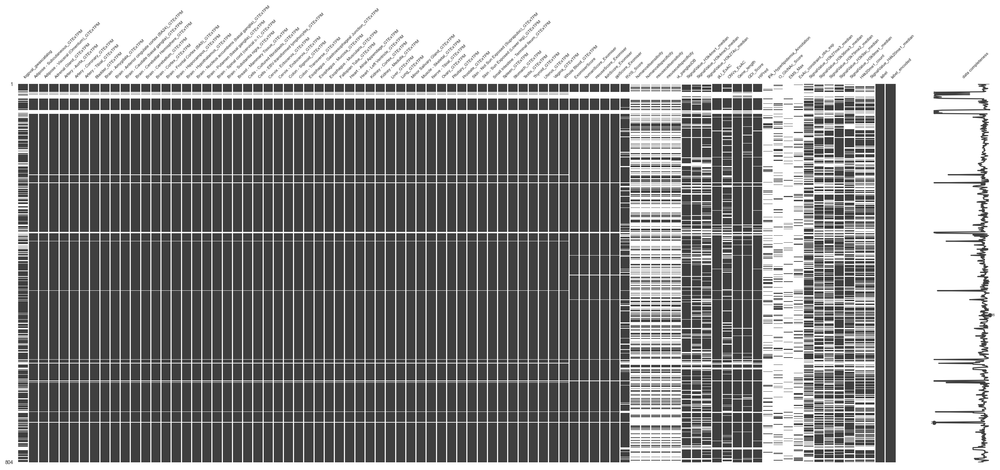

In [6]:
msno.matrix(data, labels=True, fontsize=6)

In [7]:
plt.rcParams["legend.title_fontsize"] = "large"
fig = msno.heatmap(data, figsize=(75, 75))
fig_copy = fig.get_figure()
fig_copy.savefig("missing_corr.png", format="png", dpi=300, bbox_inches="tight")

In [8]:
data.isnull().sum()

logpval_gwascatalog                     211
Adipose - Subcutaneous_GTExTPM           35
Adipose - Visceral (Omentum)_GTExTPM     35
Adrenal Gland_GTExTPM                    35
Artery - Aorta_GTExTPM                   35
                                       ... 
SignalValue_H3k9me1_median              241
H4k20me1_count                          333
SignalValue_H4k20me1_median             333
label                                     0
label_encoded                             0
Length: 86, dtype: int64

In [9]:
natest = data.isnull().sum()
natest.sort_values(inplace=True)

In [10]:
percent_missing = data.isnull().sum() * 100 / len(data)
missing_value_df = pd.DataFrame(
    {"column_name": data.columns, "percent_missing": percent_missing}
)
missing_value_df.sort_values("percent_missing", inplace=True)

In [11]:
natest = natest.to_frame()
missingdata = natest.join(missing_value_df)

In [12]:
missingdata.to_csv("traininggenes_features_with_NA.csv")

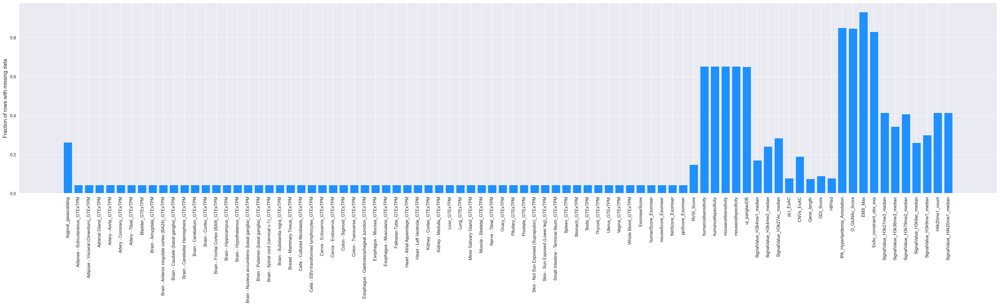

In [13]:
data_drop = data.drop(["label", "label_encoded",], 1)

null_counts = data_drop.isnull().sum() / len(data_drop)
plt.figure(figsize=(40, 8))
plt.xticks(np.arange(len(null_counts)) + 0.0, null_counts.index, rotation="vertical")
plt.ylabel("Fraction of rows with missing data")
plt.bar(np.arange(len(null_counts)), null_counts, color="dodgerblue")
plt.savefig("training_missingness.png", format="png", dpi=300, bbox_inches="tight")

In [14]:
selection = missing_value_df[missing_value_df["percent_missing"] < 25.00]
list(selection["column_name"])

['label_encoded',
 'label',
 'Heart - Atrial Appendage_GTExTPM',
 'Heart - Left Ventricle_GTExTPM',
 'Kidney - Cortex_GTExTPM',
 'Kidney - Medulla_GTExTPM',
 'Liver_GTExTPM',
 'Lung_GTExTPM',
 'Minor Salivary Gland_GTExTPM',
 'Muscle - Skeletal_GTExTPM',
 'Nerve - Tibial_GTExTPM',
 'Ovary_GTExTPM',
 'Prostate_GTExTPM',
 'Skin - Not Sun Exposed (Suprapubic)_GTExTPM',
 'Skin - Sun Exposed (Lower leg)_GTExTPM',
 'Small Intestine - Terminal Ileum_GTExTPM',
 'Spleen_GTExTPM',
 'Stomach_GTExTPM',
 'Testis_GTExTPM',
 'Thyroid_GTExTPM',
 'Uterus_GTExTPM',
 'Vagina_GTExTPM',
 'Whole Blood_GTExTPM',
 'ExomiserScore',
 'humanScore_Exomiser',
 'mouseScore_Exomiser',
 'fishScore_Exomiser',
 'ppiScore_Exomiser',
 'Fallopian Tube_GTExTPM',
 'Esophagus - Muscularis_GTExTPM',
 'Pituitary_GTExTPM',
 'Esophagus - Gastroesophageal Junction_GTExTPM',
 'Esophagus - Mucosa_GTExTPM',
 'Adipose - Visceral (Omentum)_GTExTPM',
 'Adrenal Gland_GTExTPM',
 'Artery - Aorta_GTExTPM',
 'Artery - Coronary_GTExTPM',
 'A

## Feature Correlation:

In [15]:
dat = data[list(selection["column_name"])]
dat["Gene"] = dataset["Gene"]

dt2 = dat
dat = dat.set_index("Gene")

df = dt2
df = df.set_index("Gene")
df["label_encoded"] = df["label"].map(
    {"most likely": 1, "probable": 0.75, "least likely": 0.1}
)

# removing remaining variant-level features strongly correlating with gene length:
df = df.drop(
    [
        "label",
        "Gene_length",
        "CADD_RAW",
        "gwastrait",
        "HIPred",
        "DNaseCluster_count",
        "H3k4me1_count",
        "CpGcount",
        "EnhancerCount",
        "H3k4me3_count",
        "H3k27Ac_count",
    ],
    1,
    errors="ignore",
)
df.shape

(804, 65)

In [16]:
X = MinMaxScaler().fit_transform(df)
imputer = MissForest(random_state=seed)
X = pd.DataFrame(imputer.fit_transform(X), index=df.index, columns=df.columns)

Iteration: 0
Iteration: 1
Iteration: 2


label_encoded                    1.000000
EMS_Max                          0.338139
humanScore_Exomiser              0.212219
ExomiserScore                    0.212219
Brain - Cerebellum_GTExTPM       0.093292
                                   ...   
SignalValue_H3k79me2_median     -0.101649
mouseScore_Exomiser                   NaN
fishScore_Exomiser                    NaN
ppiScore_Exomiser                     NaN
IPA_Hyperlipidemia_Annotation         NaN
Name: label_encoded, Length: 85, dtype: float64


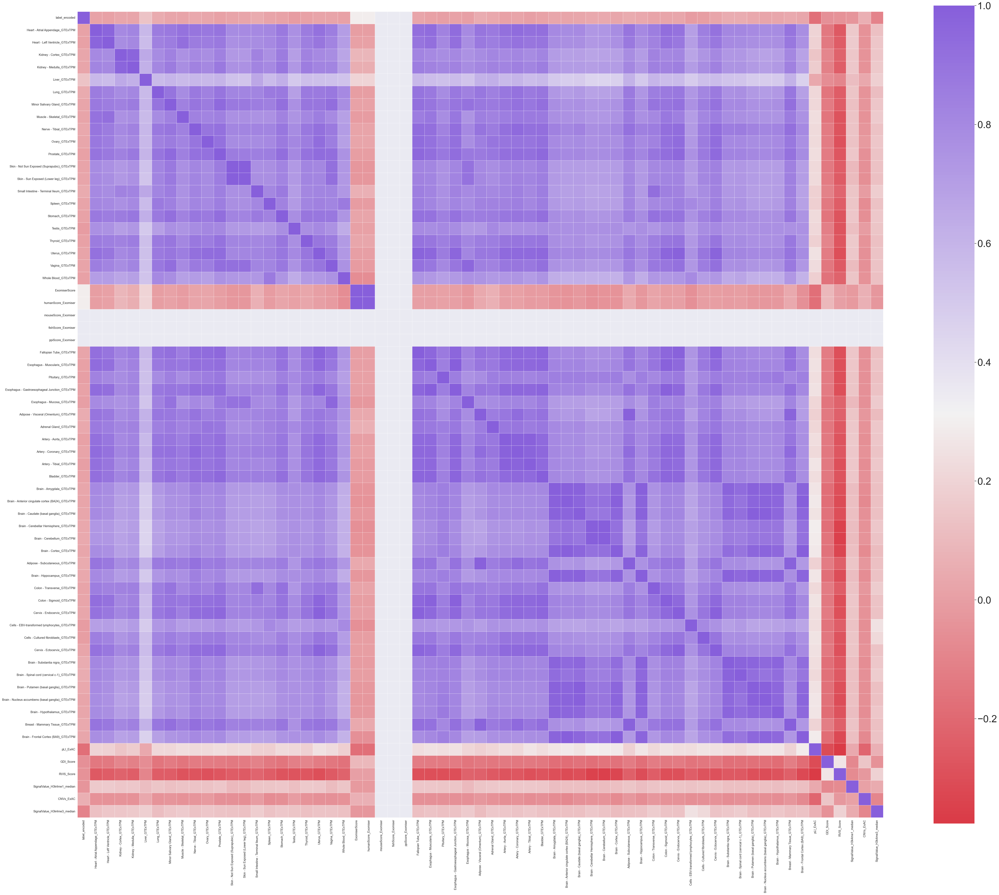

In [17]:
Xcor = X

Xcor = pd.DataFrame(data=Xcor, columns=X.columns)

corr = Xcor.corr(method="spearman")

f, ax = plt.subplots(figsize=(60, 50))

cmap = sns.diverging_palette(10, 275, as_cmap=True)
sns.set(font_scale=3)

htmap = sns.heatmap(
    corr,
    cmap=cmap,
    square=True,
    xticklabels=True,
    yticklabels=True,
    linewidths=0.5,
    ax=ax,
)

figure = htmap.get_figure()
figure.savefig("correlation_heatmap.png", format="png", dpi=300, bbox_inches="tight")

corr_matrix = data.corr()
print(corr_matrix["label_encoded"].sort_values(ascending=False))
corr = corr_matrix["label_encoded"].sort_values(ascending=False)

In [18]:
def corrFilter(x: pd.DataFrame, bound: float):
    xCorr = x.corr()
    xFiltered = xCorr[((xCorr >= bound) | (xCorr <= -bound)) & (xCorr != 1.000)]
    xFlattened = xFiltered.unstack().sort_values().drop_duplicates()
    return xFlattened


corrFilter(X, 0.9)

pairs = corrFilter(X, 0.9)
pairs.to_csv("corr_pairs09.csv", header=True)

In [19]:
corr_matrix.to_csv("corr_matrix.csv", header=True)

In [20]:
corr.to_csv("training_correlation.csv", header=True)

In [21]:
corr = X.corr()
corr.head()

,label_encoded,Heart - Atrial Appendage_GTExTPM,Heart - Left Ventricle_GTExTPM,Kidney - Cortex_GTExTPM,Kidney - Medulla_GTExTPM,Liver_GTExTPM,Lung_GTExTPM,Minor Salivary Gland_GTExTPM,Muscle - Skeletal_GTExTPM,Nerve - Tibial_GTExTPM,...,Brain - Nucleus accumbens (basal ganglia)_GTExTPM,Brain - Hypothalamus_GTExTPM,Breast - Mammary Tissue_GTExTPM,Brain - Frontal Cortex (BA9)_GTExTPM,pLI_ExAC,GDI_Score,RVIS_Score,SignalValue_H3k4me1_median,CNVs_ExAC,SignalValue_H3k4me3_median
label_encoded,1.000000,0.018136,0.015468,0.043161,0.024721,0.039291,0.028420,0.025073,0.028711,0.016046,...,0.063557,0.056548,0.029754,0.048030,-0.074351,0.056161,-0.039139,-0.016023,0.079737,-0.022978
Heart - Atrial Appendage_GTExTPM,0.018136,1.000000,0.360652,0.859758,0.660109,0.049005,0.707473,0.627152,0.512885,0.300655,...,0.559466,0.682976,0.605535,0.759270,0.053443,-0.051705,-0.045779,0.007041,0.042207,0.130602
Heart - Left Ventricle_GTExTPM,0.015468,0.360652,1.000000,0.256996,0.191284,0.002435,0.149329,0.165880,0.512433,0.131310,...,0.133381,0.180333,0.177392,0.189820,0.041374,-0.035989,-0.015804,-0.048973,0.014691,0.023957
Kidney - Cortex_GTExTPM,0.043161,0.859758,0.256996,1.000000,0.742200,0.091048,0.672991,0.594860,0.377211,0.246568,...,0.720093,0.787076,0.537595,0.773392,0.039987,-0.047822,-0.021971,0.000913,0.005248,0.110854
Kidney - Medulla_GTExTPM,0.024721,0.660109,0.191284,0.742200,1.000000,0.028606,0.511880,0.455471,0.286341,0.187806,...,0.402708,0.490010,0.408276,0.542080,0.028418,-0.039128,-0.029272,-0.006138,0.001152,0.087242


In [22]:
Xcor = X
Xcor = pd.DataFrame(data=Xcor, columns=X.columns)
corr = Xcor.corr(method="spearman").abs()
upper = corr.where(np.triu(np.ones(corr.shape), k=1).astype(np.bool))
to_drop = [column for column in upper.columns if any(upper[column] > 0.9)]
print("Dropped features with > 0.9 correlation:", to_drop)

Dropped features with > 0.9 correlation: ['Heart - Left Ventricle_GTExTPM', 'Kidney - Medulla_GTExTPM', 'Minor Salivary Gland_GTExTPM', 'Muscle - Skeletal_GTExTPM', 'Prostate_GTExTPM', 'Skin - Sun Exposed (Lower leg)_GTExTPM', 'Stomach_GTExTPM', 'Thyroid_GTExTPM', 'Uterus_GTExTPM', 'Vagina_GTExTPM', 'humanScore_Exomiser', 'Fallopian Tube_GTExTPM', 'Esophagus - Muscularis_GTExTPM', 'Esophagus - Gastroesophageal Junction_GTExTPM', 'Esophagus - Mucosa_GTExTPM', 'Adipose - Visceral (Omentum)_GTExTPM', 'Artery - Aorta_GTExTPM', 'Artery - Coronary_GTExTPM', 'Artery - Tibial_GTExTPM', 'Bladder_GTExTPM', 'Brain - Anterior cingulate cortex (BA24)_GTExTPM', 'Brain - Caudate (basal ganglia)_GTExTPM', 'Brain - Cerebellar Hemisphere_GTExTPM', 'Brain - Cerebellum_GTExTPM', 'Brain - Cortex_GTExTPM', 'Adipose - Subcutaneous_GTExTPM', 'Brain - Hippocampus_GTExTPM', 'Colon - Transverse_GTExTPM', 'Colon - Sigmoid_GTExTPM', 'Cervix - Endocervix_GTExTPM', 'Cervix - Ectocervix_GTExTPM', 'Brain - Substantia 

In [23]:
selected_columns = X.drop(X[to_drop], axis=1)
list(selected_columns)

['label_encoded',
 'Heart - Atrial Appendage_GTExTPM',
 'Kidney - Cortex_GTExTPM',
 'Liver_GTExTPM',
 'Lung_GTExTPM',
 'Nerve - Tibial_GTExTPM',
 'Ovary_GTExTPM',
 'Skin - Not Sun Exposed (Suprapubic)_GTExTPM',
 'Small Intestine - Terminal Ileum_GTExTPM',
 'Spleen_GTExTPM',
 'Testis_GTExTPM',
 'Whole Blood_GTExTPM',
 'ExomiserScore',
 'mouseScore_Exomiser',
 'fishScore_Exomiser',
 'ppiScore_Exomiser',
 'Pituitary_GTExTPM',
 'Adrenal Gland_GTExTPM',
 'Brain - Amygdala_GTExTPM',
 'Cells - EBV-transformed lymphocytes_GTExTPM',
 'Cells - Cultured fibroblasts_GTExTPM',
 'pLI_ExAC',
 'GDI_Score',
 'RVIS_Score',
 'SignalValue_H3k4me1_median',
 'CNVs_ExAC',
 'SignalValue_H3k4me3_median']

### Viewing genes >25% missing rowwise for selected features (after running BorutaShap)

In [24]:
dt = dat[
    [
       'Cells - Cultured fibroblasts_GTExTPM', 'Heart - Atrial Appendage_GTExTPM', 
        'Adrenal Gland_GTExTPM', 'Testis_GTExTPM', 'humanScore_Exomiser', 'pLI_ExAC',
        'GDI_Score', 'Lung_GTExTPM', 'HIPred', 'Whole Blood_GTExTPM', 'Ovary_GTExTPM', 
        'Spleen_GTExTPM', 'Kidney - Cortex_GTExTPM', 'Pituitary_GTExTPM', 'Small Intestine - Terminal Ileum_GTExTPM', 'Liver_GTExTPM', 
        'Brain - Amygdala_GTExTPM']]


In [25]:
dt["missing_count"] = dt.isnull().sum(axis=1)

dt["missing_percentage"] = (dt["missing_count"] / 19) * 100

dt.sort_values("missing_percentage", inplace=True)
print(dt[["missing_count", "missing_percentage"]])
# dt.shape

            missing_count  missing_percentage
Gene                                         
ABCA1                   0            0.000000
NTF4                    0            0.000000
NUAK2                   0            0.000000
NUBPL                   0            0.000000
NUCKS1                  0            0.000000
...                   ...                 ...
AL354718.1             17           89.473684
AL353583.1             17           89.473684
AL139333.1             17           89.473684
AC006014.1             17           89.473684
CR769776.1             17           89.473684

[804 rows x 2 columns]


In [26]:
dtmissing = dt.loc[dt["missing_percentage"] > 25]
dtmissing

,Cells - Cultured fibroblasts_GTExTPM,Heart - Atrial Appendage_GTExTPM,Adrenal Gland_GTExTPM,Testis_GTExTPM,humanScore_Exomiser,pLI_ExAC,GDI_Score,Lung_GTExTPM,HIPred,Whole Blood_GTExTPM,Ovary_GTExTPM,Spleen_GTExTPM,Kidney - Cortex_GTExTPM,Pituitary_GTExTPM,Small Intestine - Terminal Ileum_GTExTPM,Liver_GTExTPM,Brain - Amygdala_GTExTPM,missing_count,missing_percentage
Gene,,,,,,,,,,,,,,,,,,,
GDF1,NaN,NaN,NaN,NaN,0.0,5.449237e-01,947.71674,NaN,0.285495,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,13,68.421053
CIDEB,NaN,NaN,NaN,NaN,0.0,1.520000e-11,45.39600,NaN,0.170126,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,13,68.421053
RSC1A1,NaN,NaN,NaN,NaN,0.0,1.460000e-08,1729.18109,NaN,0.146139,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,13,68.421053
AC114494.1,NaN,NaN,NaN,NaN,NaN,2.967916e-02,3370.65082,NaN,0.123297,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,14,73.684211
PRAMEF22,NaN,NaN,NaN,NaN,0.0,6.171469e-01,NaN,NaN,0.255355,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,14,73.684211
SPATA31A2,NaN,NaN,NaN,NaN,NaN,4.323548e-01,NaN,NaN,0.139343,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,15,78.947368
AC019171.1,NaN,NaN,NaN,NaN,NaN,NaN,19.54317,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,16,84.210526
AL049829.1,NaN,NaN,NaN,NaN,NaN,NaN,93.96157,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,16,84.210526
FLJ00388,NaN,NaN,NaN,NaN,NaN,NaN,23.26524,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,16,84.210526


### Gene length distribution:


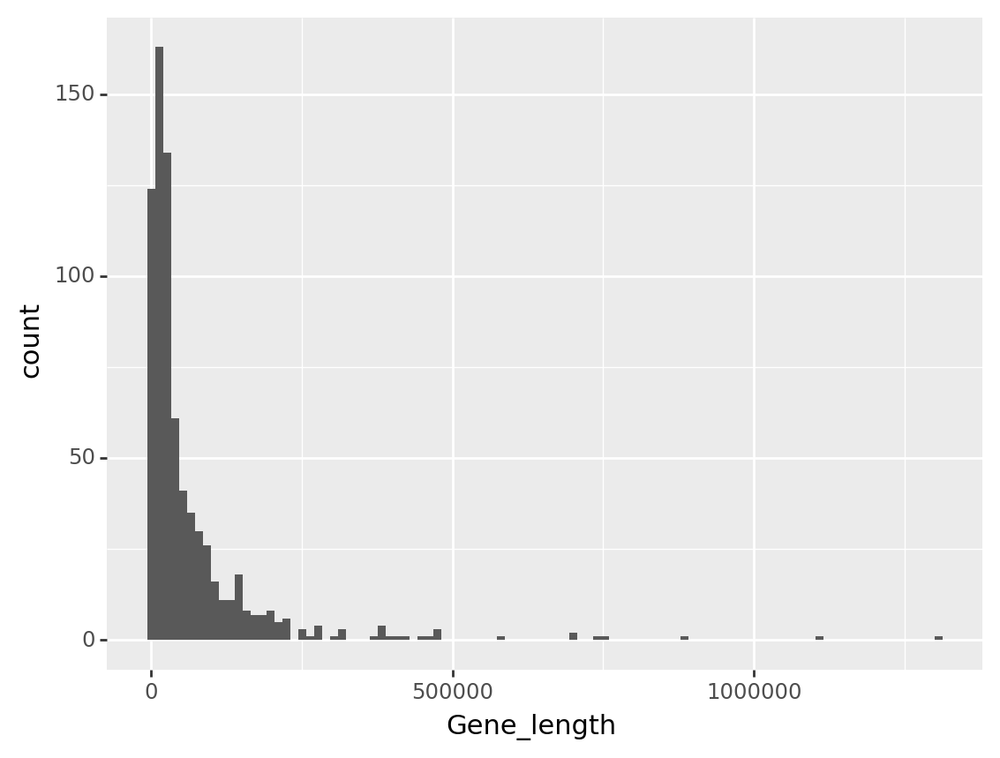

<ggplot: (8789869726883)>

In [27]:
(ggplot(dat, aes(x="Gene_length")) + geom_histogram())

In [28]:
dt_ml = data.loc[data["label_encoded"] == 1.0]

dt_ml = dt_ml[
    [
    'Cells - Cultured fibroblasts_GTExTPM', 'Heart - Atrial Appendage_GTExTPM', 'Adrenal Gland_GTExTPM', 'Testis_GTExTPM', 'humanScore_Exomiser', 'pLI_ExAC', 'GDI_Score', 'Lung_GTExTPM', 'HIPred', 'Whole Blood_GTExTPM', 'Ovary_GTExTPM', 'Spleen_GTExTPM', 'Kidney - Cortex_GTExTPM', 'Pituitary_GTExTPM', 'Small Intestine - Terminal Ileum_GTExTPM', 'Liver_GTExTPM', 'Brain - Amygdala_GTExTPM']]

dt_ll = data.loc[data["label_encoded"] == 0.1]

dt_ll = dt_ll[
    [
   'Cells - Cultured fibroblasts_GTExTPM', 'Heart - Atrial Appendage_GTExTPM', 'Adrenal Gland_GTExTPM', 'Testis_GTExTPM', 'humanScore_Exomiser', 'pLI_ExAC', 'GDI_Score', 'Lung_GTExTPM', 'HIPred', 'Whole Blood_GTExTPM', 'Ovary_GTExTPM', 'Spleen_GTExTPM', 'Kidney - Cortex_GTExTPM', 'Pituitary_GTExTPM', 'Small Intestine - Terminal Ileum_GTExTPM', 'Liver_GTExTPM', 'Brain - Amygdala_GTExTPM' ]]

target_0 = data.loc[data["label_encoded"] == 0.1]
target_1 = data.loc[data["label_encoded"] == 1]
target_2 = data.loc[data["label_encoded"] == 0.75]
combo = pd.concat([target_0, target_1])
combo2 = pd.concat([target_0, target_1, target_2])

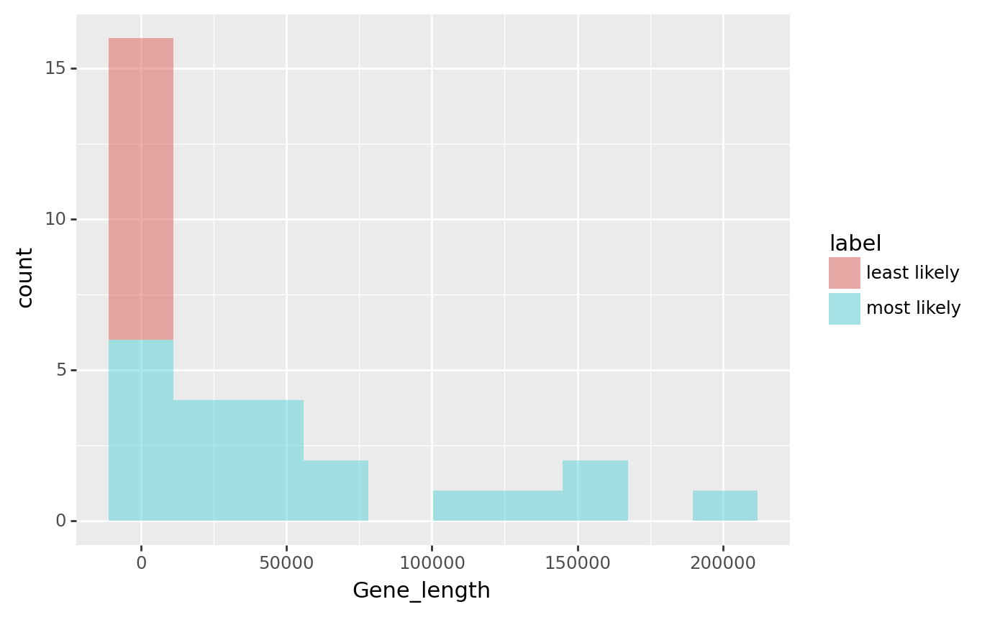

<ggplot: (8789886323277)>

In [29]:
(ggplot(combo, aes(x="Gene_length", fill="label")) + geom_histogram(alpha=0.5))

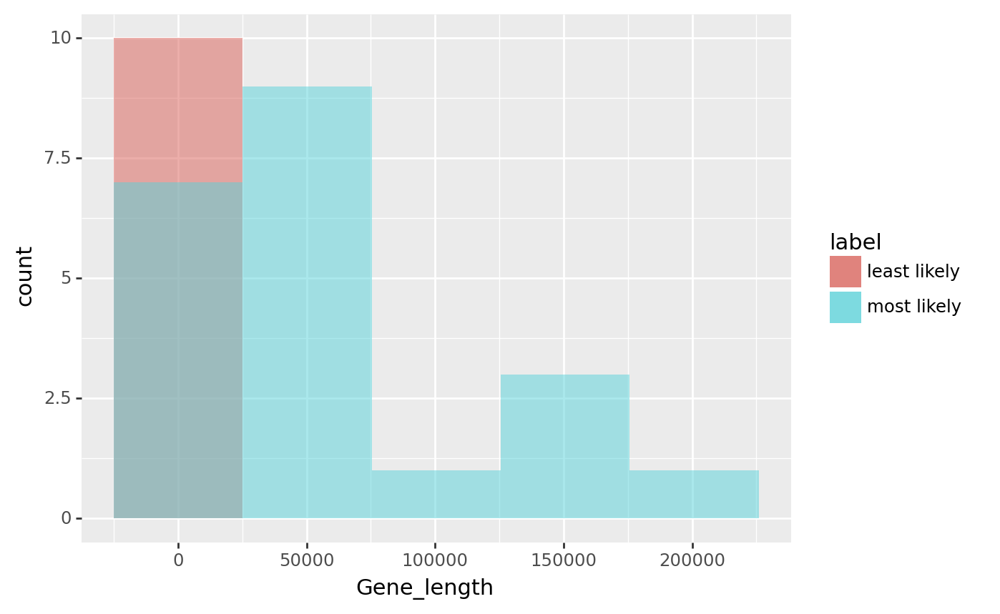

<ggplot: (8789789081871)>

In [30]:
(
    ggplot()
    + geom_histogram(target_0, aes(x="Gene_length", fill="label"), alpha=0.5)
    + geom_histogram(target_1, aes(x="Gene_length", fill="label"), alpha=0.5)
)

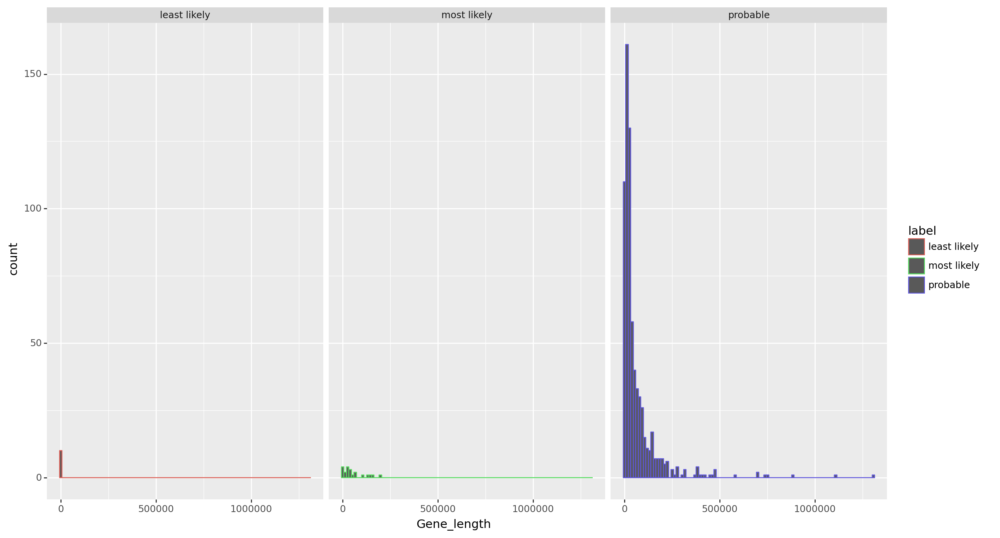

<ggplot: (8789886306109)>

In [31]:
ggplot(combo2, aes(x="Gene_length", color="label")) + geom_histogram() + facet_wrap(
    ["label"]
) + theme(figure_size=(14, 8))

### Feature distribution:

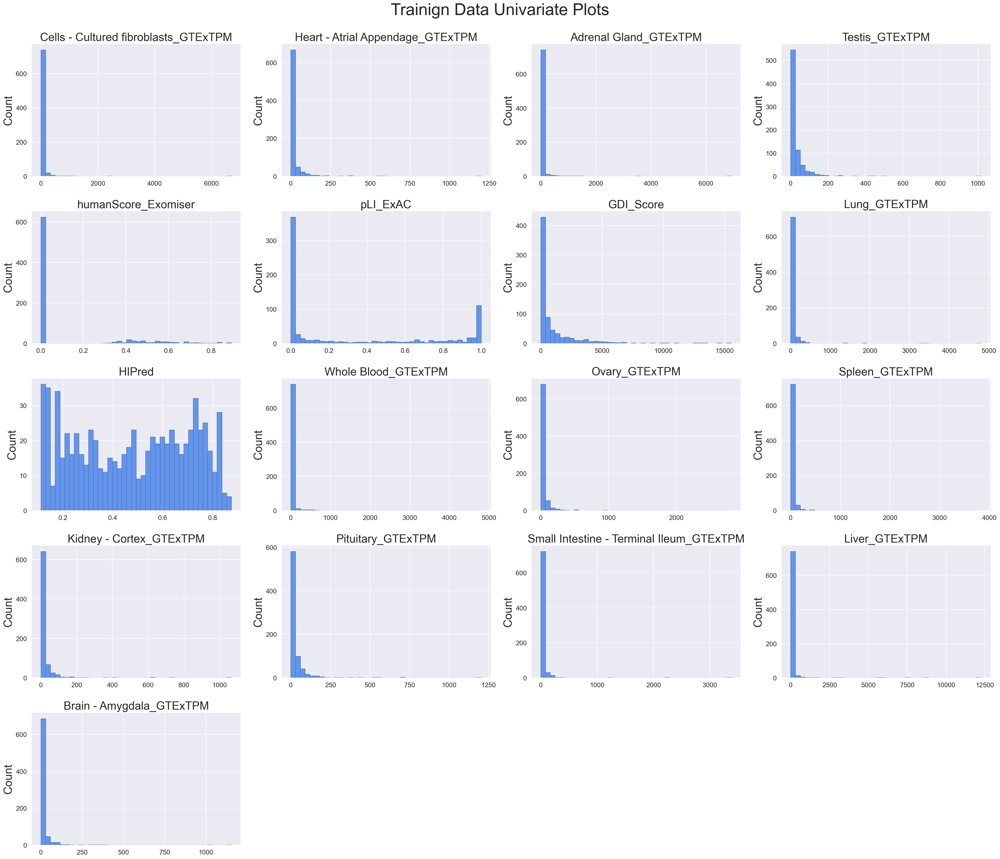

In [32]:
sns.set(font_scale=2)
features_list = [
'Cells - Cultured fibroblasts_GTExTPM', 'Heart - Atrial Appendage_GTExTPM', 'Adrenal Gland_GTExTPM', 'Testis_GTExTPM', 'humanScore_Exomiser', 'pLI_ExAC', 'GDI_Score', 'Lung_GTExTPM', 'HIPred', 'Whole Blood_GTExTPM', 'Ovary_GTExTPM', 'Spleen_GTExTPM', 'Kidney - Cortex_GTExTPM', 'Pituitary_GTExTPM', 'Small Intestine - Terminal Ileum_GTExTPM', 'Liver_GTExTPM', 'Brain - Amygdala_GTExTPM'
]


axarr = dt[features_list].hist(
    bins=40,
    edgecolor="b",
    linewidth=1.0,
    xlabelsize=14,
    ylabelsize=14,
    stacked=True,
    figsize=(30, 25),
    color="cornflowerblue",
)

for ax in axarr.flatten():
    ax.set_ylabel("Count")

plt.tight_layout()
plt.grid(axis="x", color="0.95")
plt.suptitle("Trainign Data Univariate Plots", y=1.02, fontsize=35)

plt.savefig(
    "training_gene_feature_distribution.png", format="png", dpi=300, bbox_inches="tight"
)

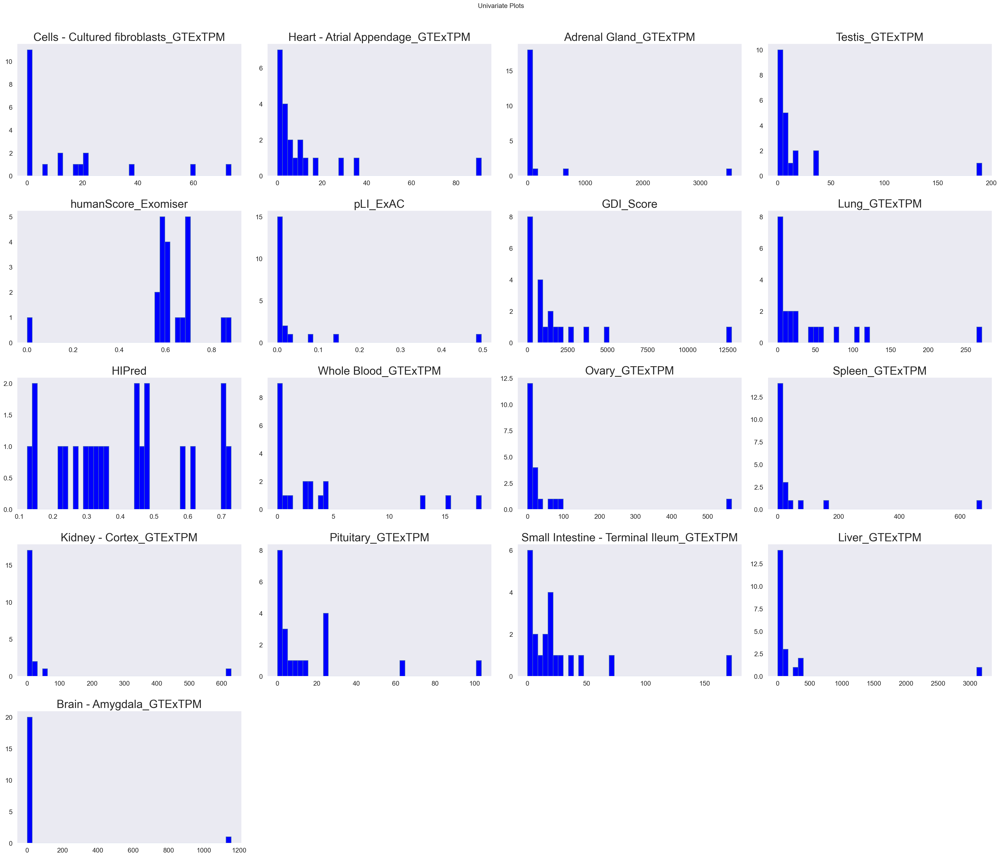

In [33]:
# most likely genes

dt_ml = data.loc[data["label_encoded"] == 1.0]

dt_ml = dt_ml[
    [
'Cells - Cultured fibroblasts_GTExTPM', 'Heart - Atrial Appendage_GTExTPM', 'Adrenal Gland_GTExTPM', 'Testis_GTExTPM', 'humanScore_Exomiser', 'pLI_ExAC', 'GDI_Score', 'Lung_GTExTPM', 'HIPred', 'Whole Blood_GTExTPM', 'Ovary_GTExTPM', 'Spleen_GTExTPM', 'Kidney - Cortex_GTExTPM', 'Pituitary_GTExTPM', 'Small Intestine - Terminal Ileum_GTExTPM', 'Liver_GTExTPM', 'Brain - Amygdala_GTExTPM'
    ]
]

sns.set(font_scale=2)
features_list = list(dt_ml.columns)

dt_ml[features_list].hist(
    bins=40,
    edgecolor="b",
    linewidth=1.0,
    xlabelsize=14,
    ylabelsize=14,
    grid=False,
    figsize=(30, 25),
    color="blue",
)
plt.tight_layout()

plt.suptitle("Univariate Plots", y=1.02, fontsize=14);

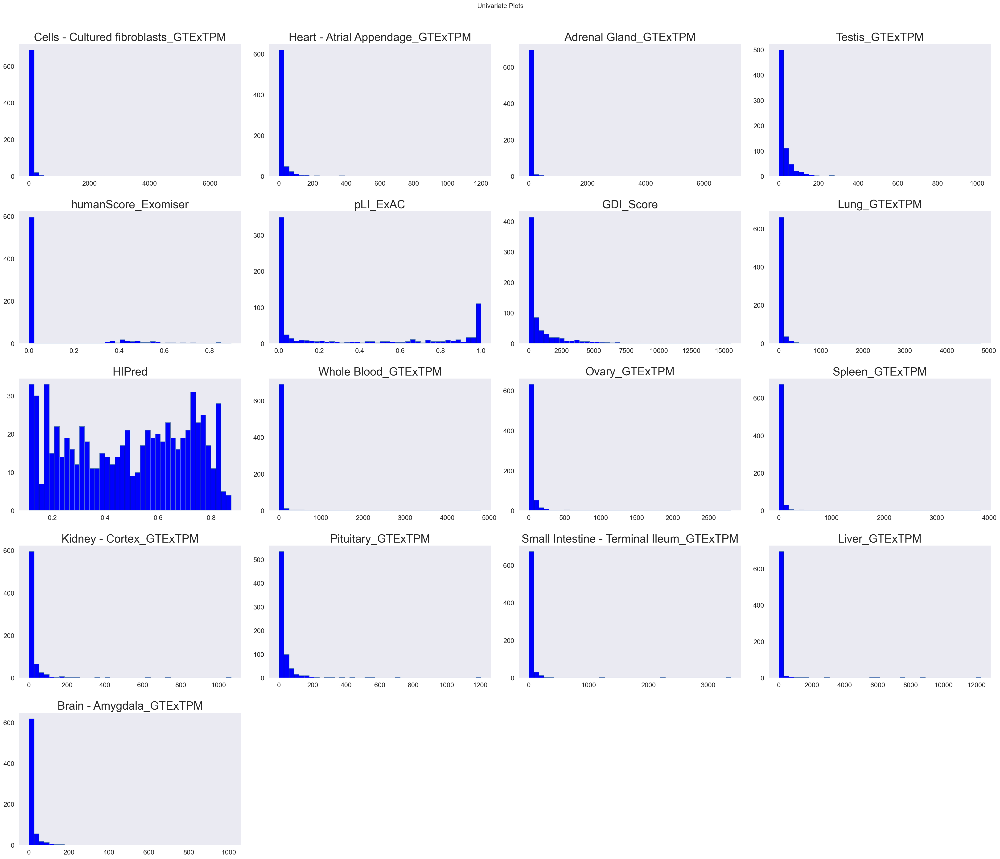

In [34]:
# probable genes

dt_p = data.loc[data["label_encoded"] == 0.75]

dt_p = dt_p[
    [
'Cells - Cultured fibroblasts_GTExTPM', 'Heart - Atrial Appendage_GTExTPM', 'Adrenal Gland_GTExTPM', 'Testis_GTExTPM', 'humanScore_Exomiser', 'pLI_ExAC', 'GDI_Score', 'Lung_GTExTPM', 'HIPred', 'Whole Blood_GTExTPM', 'Ovary_GTExTPM', 'Spleen_GTExTPM', 'Kidney - Cortex_GTExTPM', 'Pituitary_GTExTPM', 'Small Intestine - Terminal Ileum_GTExTPM', 'Liver_GTExTPM', 'Brain - Amygdala_GTExTPM'
    ]
]


sns.set(font_scale=2)
features_list = list(dt_p.columns)

dt_p[features_list].hist(
    bins=40,
    edgecolor="b",
    linewidth=1.0,
    xlabelsize=14,
    ylabelsize=14,
    grid=False,
    figsize=(30, 25),
    color="blue",
)
plt.tight_layout()

plt.suptitle("Univariate Plots", y=1.02, fontsize=14);

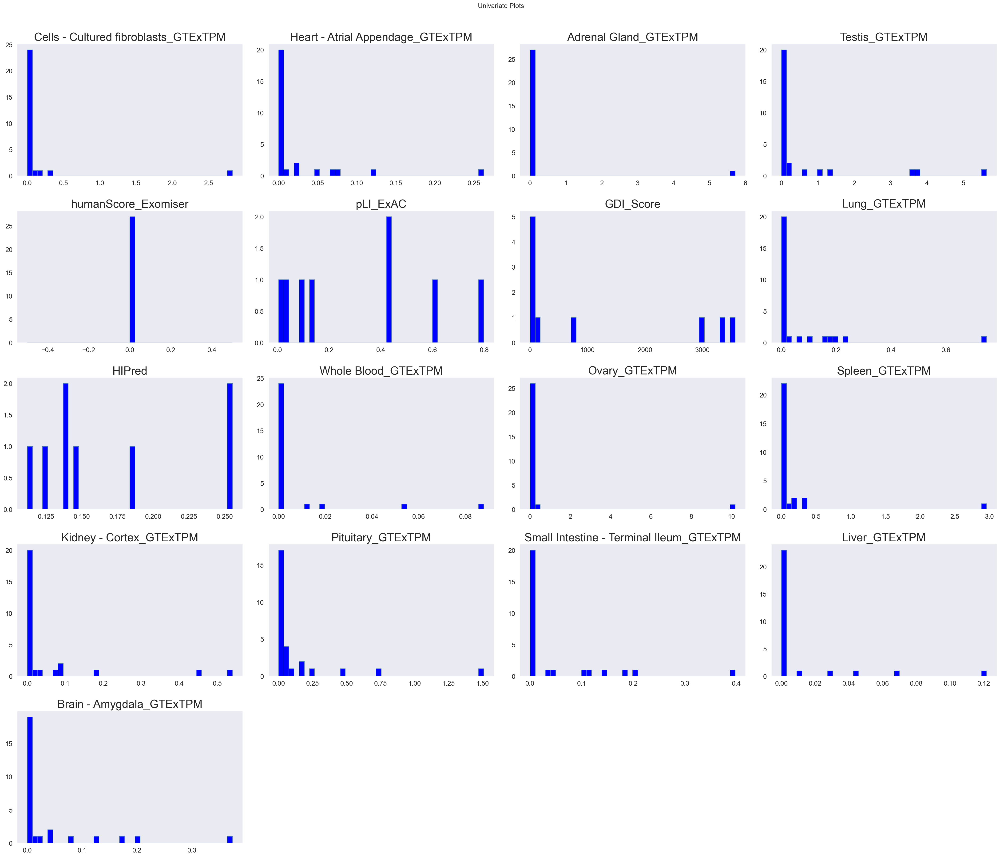

In [35]:
# least likely genes
dt_ll = data.loc[data["label_encoded"] == 0.1]

dt_ll = dt_ll[
    [
      'Cells - Cultured fibroblasts_GTExTPM', 'Heart - Atrial Appendage_GTExTPM', 'Adrenal Gland_GTExTPM', 'Testis_GTExTPM', 'humanScore_Exomiser', 'pLI_ExAC', 'GDI_Score', 'Lung_GTExTPM', 'HIPred', 'Whole Blood_GTExTPM', 'Ovary_GTExTPM', 'Spleen_GTExTPM', 'Kidney - Cortex_GTExTPM', 'Pituitary_GTExTPM', 'Small Intestine - Terminal Ileum_GTExTPM', 'Liver_GTExTPM', 'Brain - Amygdala_GTExTPM'
    ]
]

sns.set(font_scale=2)
features_list = list(dt_ll.columns)

dt_ll[features_list].hist(
    bins=40,
    edgecolor="b",
    linewidth=1.0,
    xlabelsize=14,
    ylabelsize=14,
    grid=False,
    figsize=(30, 25),
    color="blue",
)
plt.tight_layout()
ax.set_ylabel("Gene Count")

plt.suptitle("Univariate Plots", y=1.02, fontsize=14);

### Covariation Heatmaps:

Text(0.5, 1.0, 'Covariance between different features')

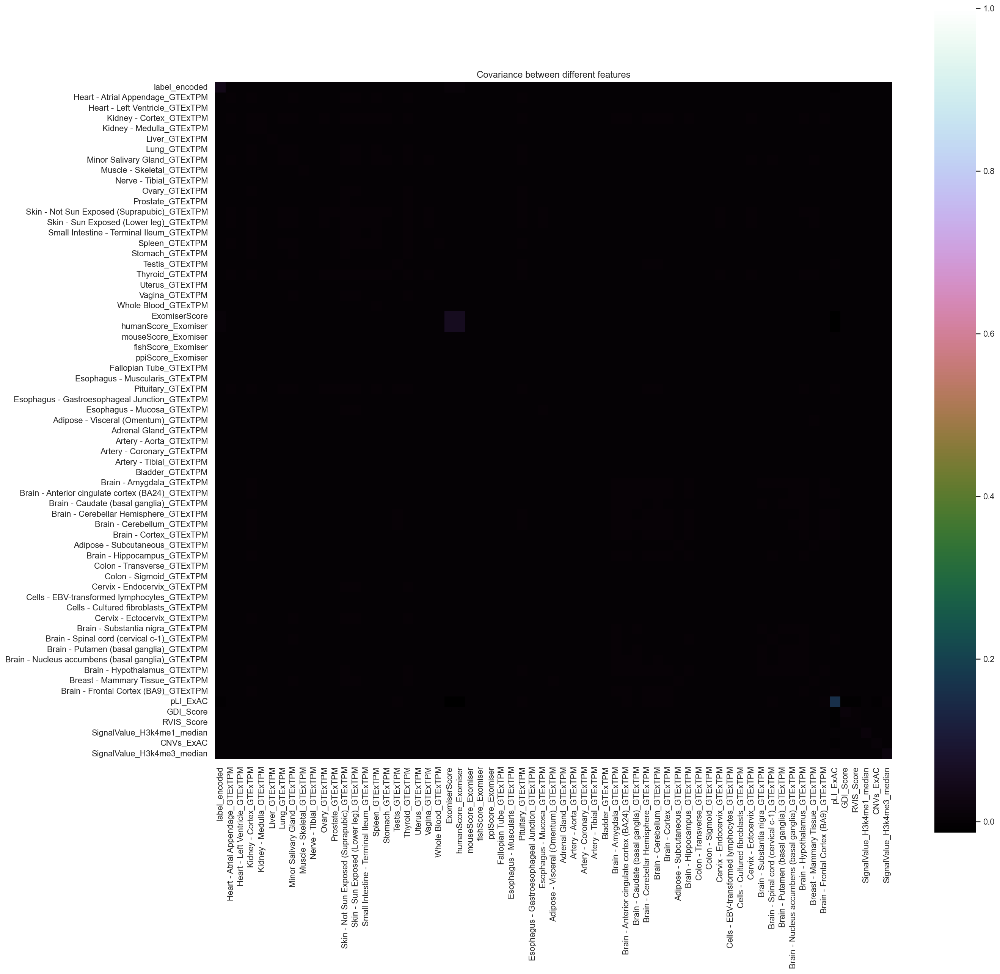

In [36]:
mean_vec = np.mean(Xcor, axis=0)
cov_mat = (Xcor - mean_vec).T.dot((Xcor - mean_vec)) / (Xcor.shape[0] - 1)
# print('Covariance matrix \n%s' %cov_mat)
sns.set(font_scale=1)
plt.figure(figsize=(20, 20))
sns.heatmap(cov_mat, vmax=1, square=True, cmap="cubehelix")

plt.title("Covariance between different features")

## Visualization of Selected Features
Features selected by BorutaShap

In [6]:
X2 = pd.read_csv("imputed_training_data.csv", header=0)
X2 = pd.concat([X2, Y], axis=1)

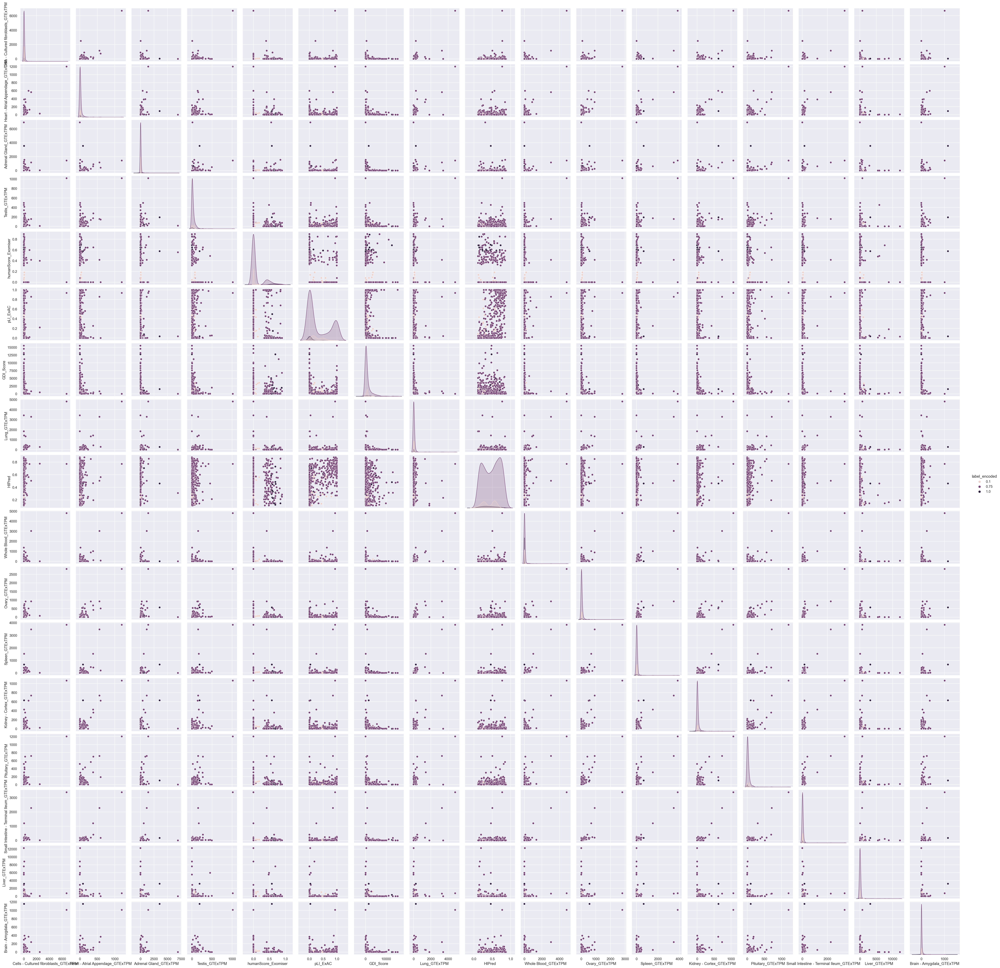

In [38]:
sns.set(font_scale=1)
Xplot = X2
sns.pairplot(
    Xplot,
    hue="label_encoded",
    vars=[
      'Cells - Cultured fibroblasts_GTExTPM', 'Heart - Atrial Appendage_GTExTPM', 'Adrenal Gland_GTExTPM',
        'Testis_GTExTPM', 'humanScore_Exomiser', 'pLI_ExAC', 'GDI_Score', 'Lung_GTExTPM', 'HIPred', 'Whole Blood_GTExTPM', 'Ovary_GTExTPM', 'Spleen_GTExTPM', 'Kidney - Cortex_GTExTPM', 'Pituitary_GTExTPM', 'Small Intestine - Terminal Ileum_GTExTPM', 'Liver_GTExTPM', 'Brain - Amygdala_GTExTPM'
    ],
)

## Mutual Information of Selected Features
Mutual information (MI) between two random variables is a non-negative value, which measures the dependency between the variables. It is equal to zero if and only if two random variables are independent, and higher values mean higher dependency.

In [39]:
X2 = X2[
    [
      'Cells - Cultured fibroblasts_GTExTPM', 'Heart - Atrial Appendage_GTExTPM', 'Adrenal Gland_GTExTPM', 'Testis_GTExTPM', 'humanScore_Exomiser', 'pLI_ExAC', 'GDI_Score', 'Lung_GTExTPM', 'HIPred', 'Whole Blood_GTExTPM', 'Ovary_GTExTPM', 
        'Spleen_GTExTPM', 'Kidney - Cortex_GTExTPM', 'Pituitary_GTExTPM', 'Small Intestine - Terminal Ileum_GTExTPM', 'Liver_GTExTPM', 'Brain - Amygdala_GTExTPM'
    ]
]

## Comparison of F-test and mutual information
As F-test captures only linear dependency, it rates x_1 (HIPred) as the most discriminative feature. On the other hand, mutual information can capture any kind of dependency between variables and it rates x_4 (HIPred) as the most discriminative feature, which probably agrees better with our intuitive perception for this example. Both methods mark GTEx tissues (x_5 - x_7) as having the least relevance.

Mutual Information:
It measures the average reduction in uncertainty about x that results from learning the value of y; or vice versa, the average amount of information that x conveys about y — Page 139, Information Theory, Inference, and Learning Algorithms, 2003.


F-Test: calculates F-statistic and does a hypothesis testing model X and Y where X is a model created by just a constant and Y is the model created by a constant and a feature.

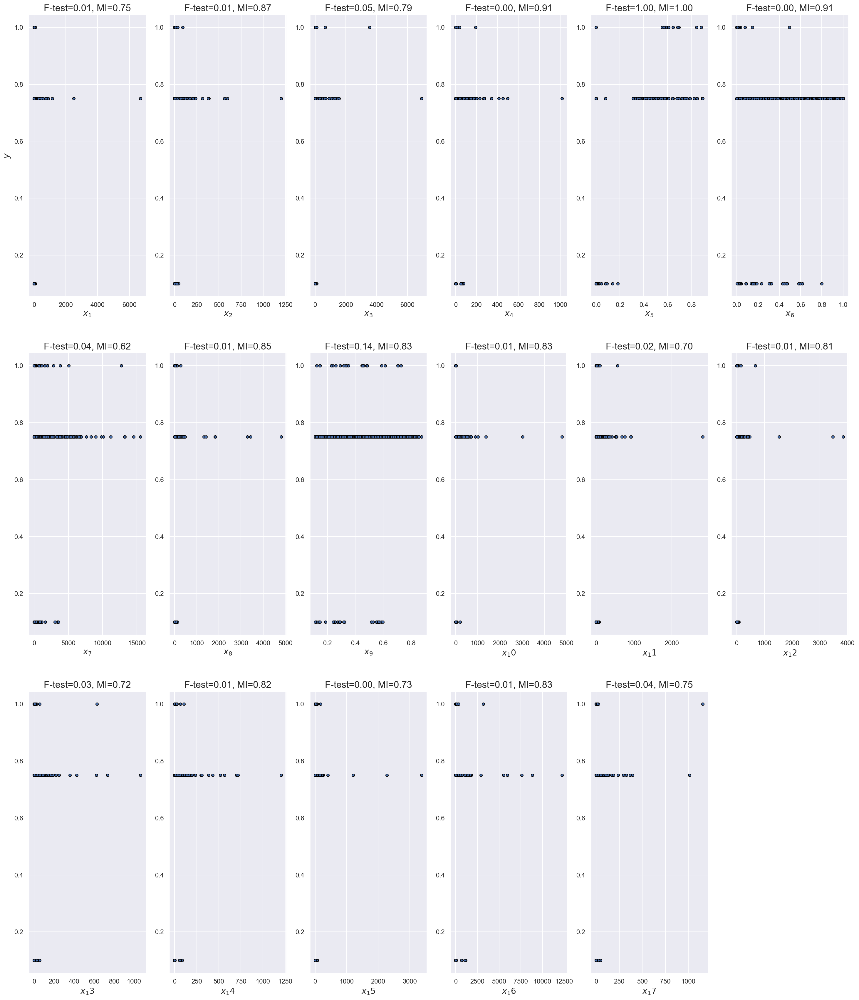

In [44]:
f_test, _ = f_regression(X2, Y)
f_test /= np.max(f_test)

mi = mutual_info_regression(X2, Y)
mi /= np.max(mi)

plt.figure(figsize=(25, 30))
for i in range(17):
    plt.subplot(3, 6, i + 1)
    plt.scatter(X2.iloc[:, i], Y, edgecolor="black", s=20)
    plt.xlabel("$x_{}$".format(i + 1), fontsize=14)
    if i == 0:
        plt.ylabel("$y$", fontsize=14)
    plt.title("F-test={:.2f}, MI={:.2f}".format(f_test[i], mi[i]), fontsize=16)
plt.show()

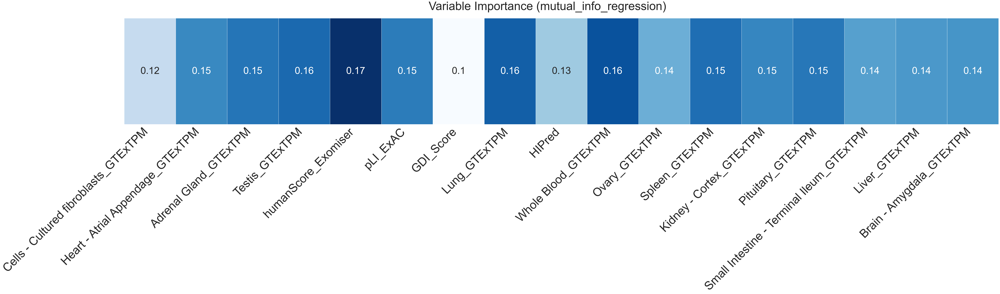

In [41]:
mutual_information = mutual_info_regression(X2, Y)

plt.subplots(1, figsize=(80, 10))
sns.heatmap(
    mutual_information[:, np.newaxis].T,
    cmap="Blues",
    cbar=False,
    linewidths=1,
    annot=True,
    annot_kws={"fontsize": 50},
)
plt.yticks([], [])
plt.gca().set_xticklabels(X2.columns, rotation=45, ha="right", fontsize=60)
plt.suptitle("Variable Importance (mutual_info_regression)", fontsize=60, y=1)
plt.gcf().subplots_adjust(wspace=0.2)
pass


plt.savefig("Mutual info gain.png", format="png", dpi=300, bbox_inches="tight")

### Selected Features Covariance and Correlation:

Text(0.5, 1.0, 'Covariance between different features')

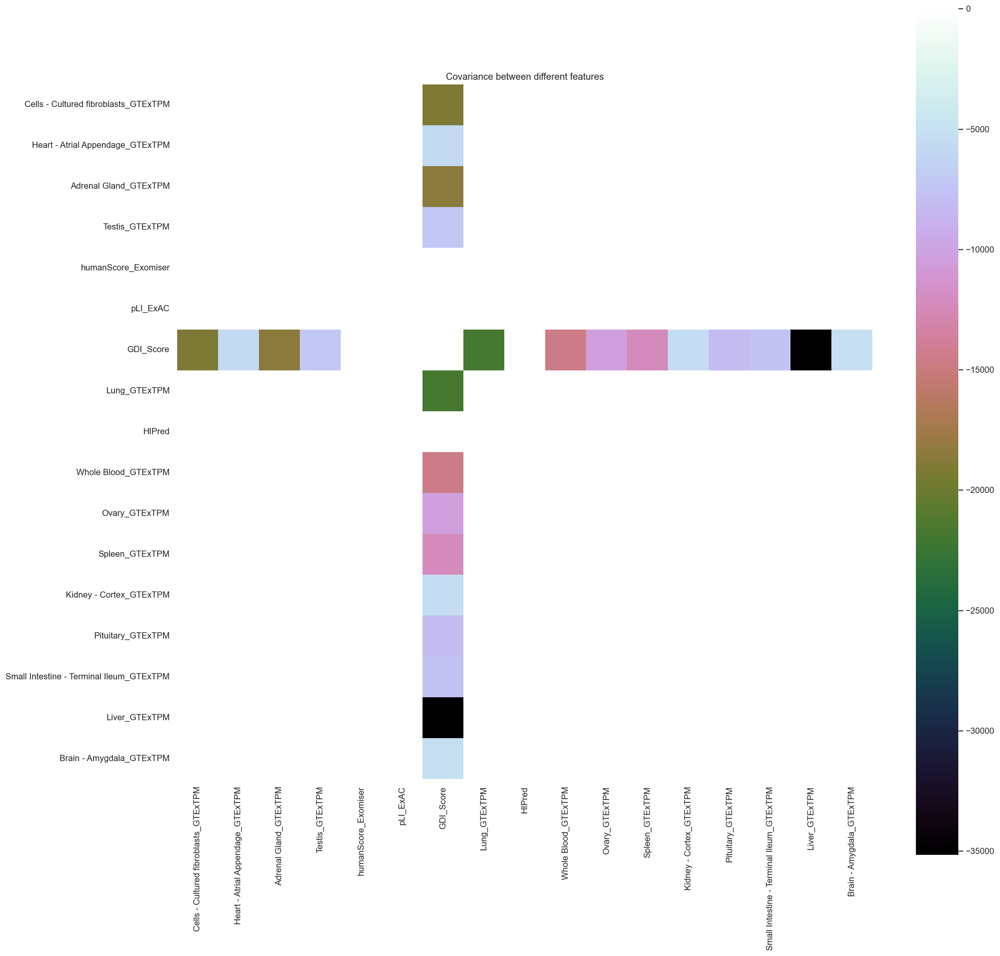

In [45]:
mean_vec = np.mean(X2, axis=0)
cov_mat = (X2 - mean_vec).T.dot((X2 - mean_vec)) / (X2.shape[0] - 1)
# print('Covariance matrix \n%s' %cov_mat)
sns.set(font_scale=1)
plt.figure(figsize=(20, 20))
sns.heatmap(cov_mat, vmax=1, square=True, cmap="cubehelix")

plt.title("Covariance between different features")

In [47]:
Xcor = X2
# Xcor.columns = [regex.sub("_", col) if any(x in str(col) for x in set(('[', ']', '<'))) else col for col in df1.columns.values]
Xcor = pd.DataFrame(data=Xcor, columns=X2.columns)
# Xcor.columns = [regex.sub("_", col) if any(x in str(col) for x in set(('[', ']', '<'))) else col for col in X.columns.values]

corr = Xcor.corr(method="spearman")

f, ax = plt.subplots(figsize=(60, 50))

# heatmap colours
cmap = sns.diverging_palette(10, 275, as_cmap=True)
sns.set(font_scale=4)
# heatmap plot of feature correlation
htmap = sns.heatmap(
    corr,
    cmap=cmap,
    square=True,
    xticklabels=True,
    yticklabels=True,
    linewidths=0.5,
    annot=True,
    annot_kws={"size": 40},
    ax=ax,
)  

figure = htmap.get_figure()
figure.savefig("selected_correlation.png", format="png", dpi=300, bbox_inches="tight")


corr_matrix = data.corr()
print(corr_matrix["label_encoded"].sort_values(ascending=False))
corr = corr_matrix["label_encoded"].sort_values(ascending=False)

label_encoded                    1.000000
EMS_Max                          0.338139
humanScore_Exomiser              0.212219
ExomiserScore                    0.212219
Brain - Cerebellum_GTExTPM       0.093292
                                   ...   
SignalValue_H3k79me2_median     -0.101649
mouseScore_Exomiser                   NaN
fishScore_Exomiser                    NaN
ppiScore_Exomiser                     NaN
IPA_Hyperlipidemia_Annotation         NaN
Name: label_encoded, Length: 85, dtype: float64


### Partial Dependence Plots

The y axis is interpreted as change in the prediction from what it would be predicted at the baseline or leftmost value.
A blue shaded area indicates level of confidence

In [7]:
seed = 0
train_X, val_X, train_y, val_y = train_test_split(X2, Y, random_state=1)
tree_model = RandomForestRegressor(
    random_state=seed,
    criterion="mse",
    max_depth=4,
    max_features="sqrt",
    n_estimators=50,
).fit(train_X, train_y)


def pdp_plotting1(feature):
    pdp_dist = pdp.pdp_isolate(
    model=tree_model, dataset=val_X, model_features=X2.columns, feature=feature)
    pdp.pdp_plot(pdp_dist, feature)
    plt.show()

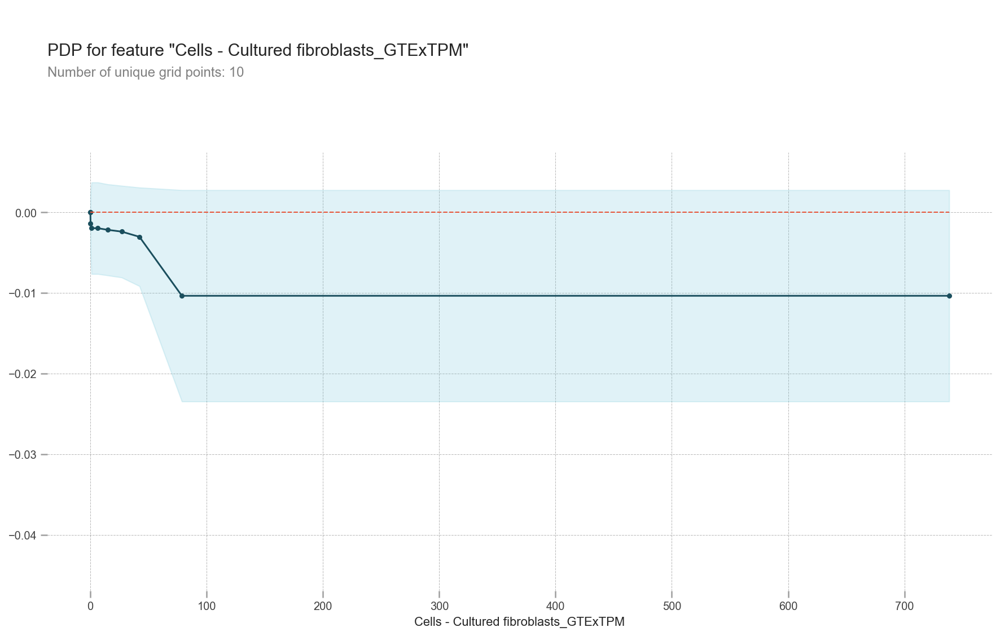

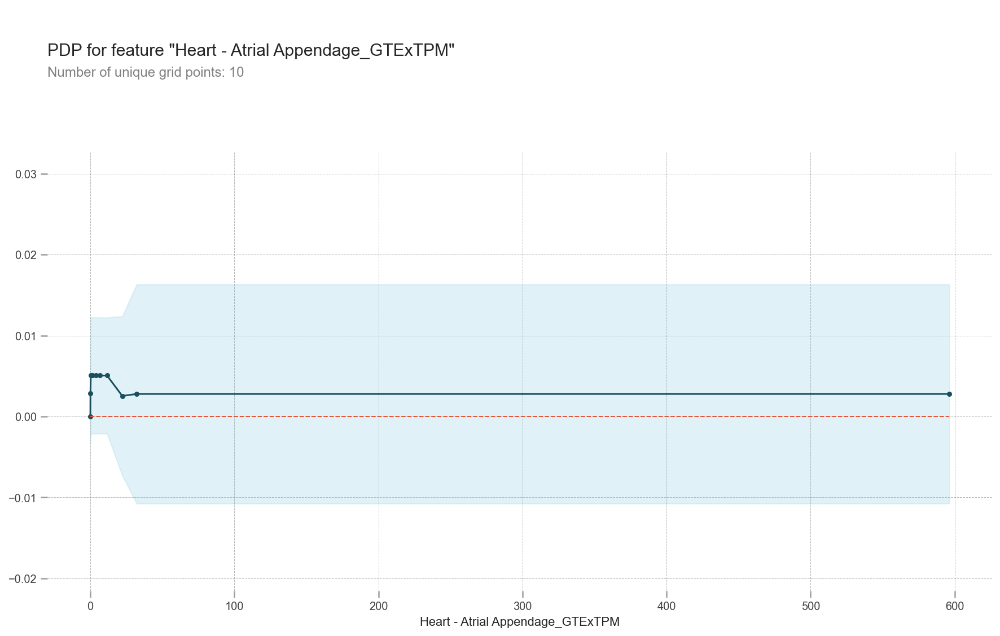

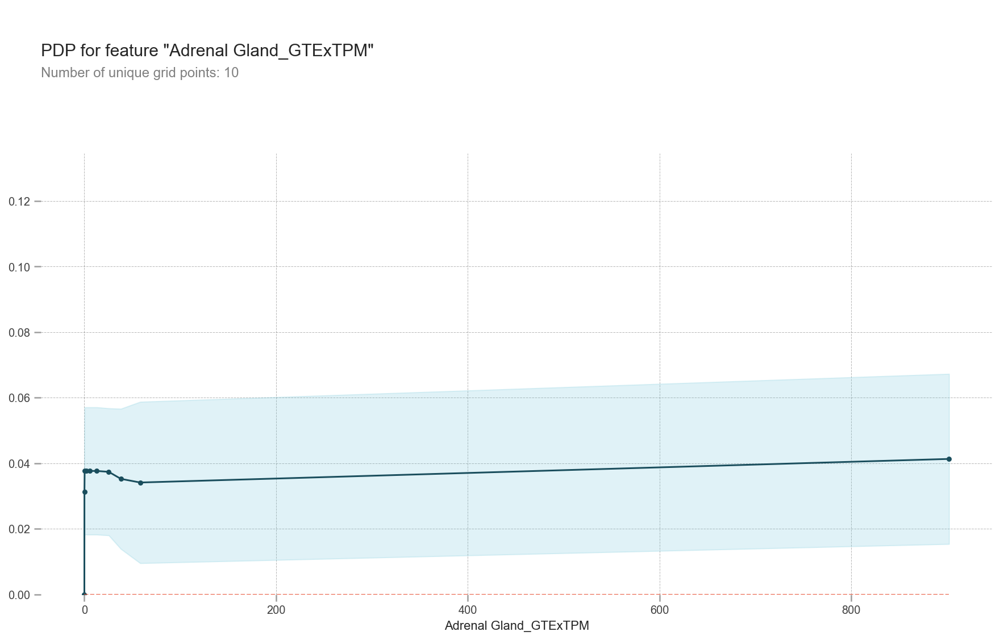

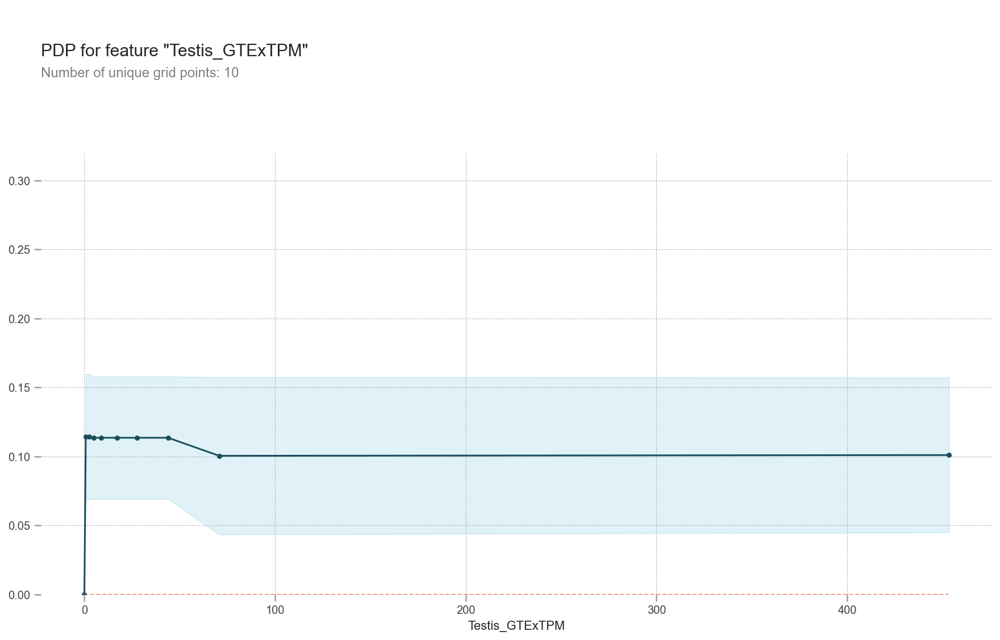

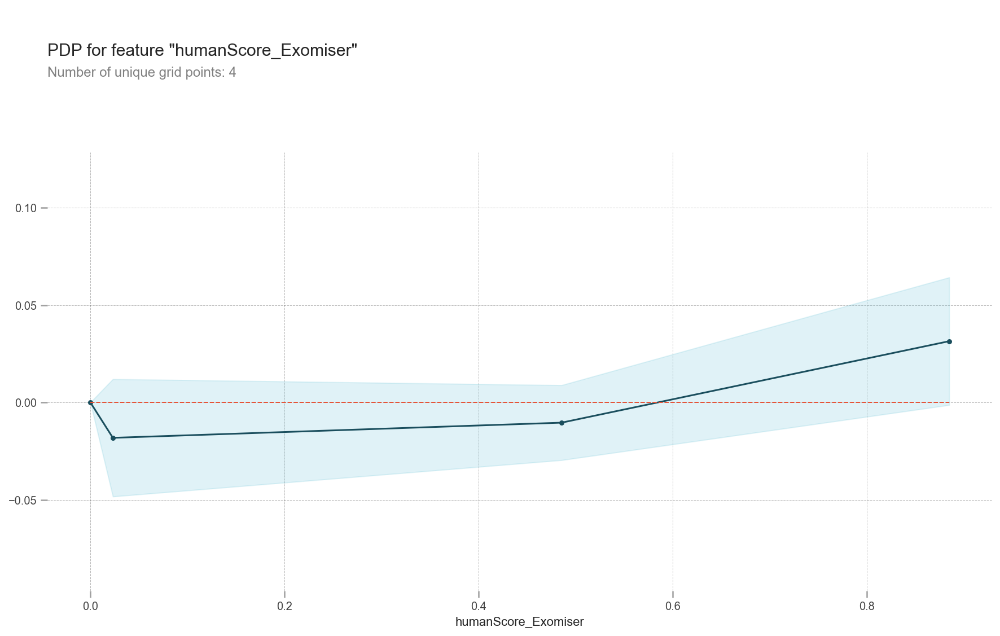

...

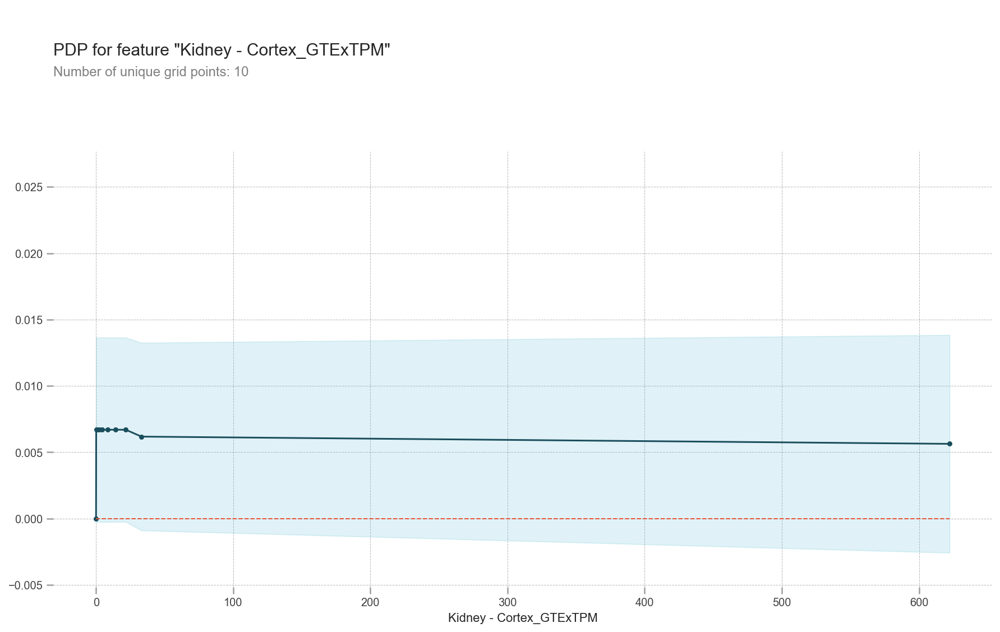

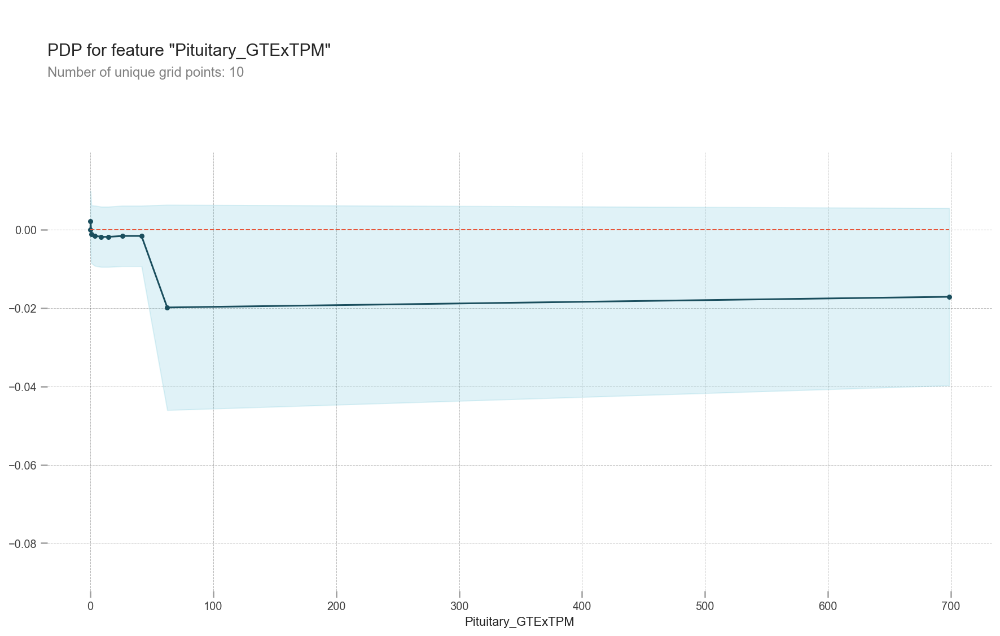

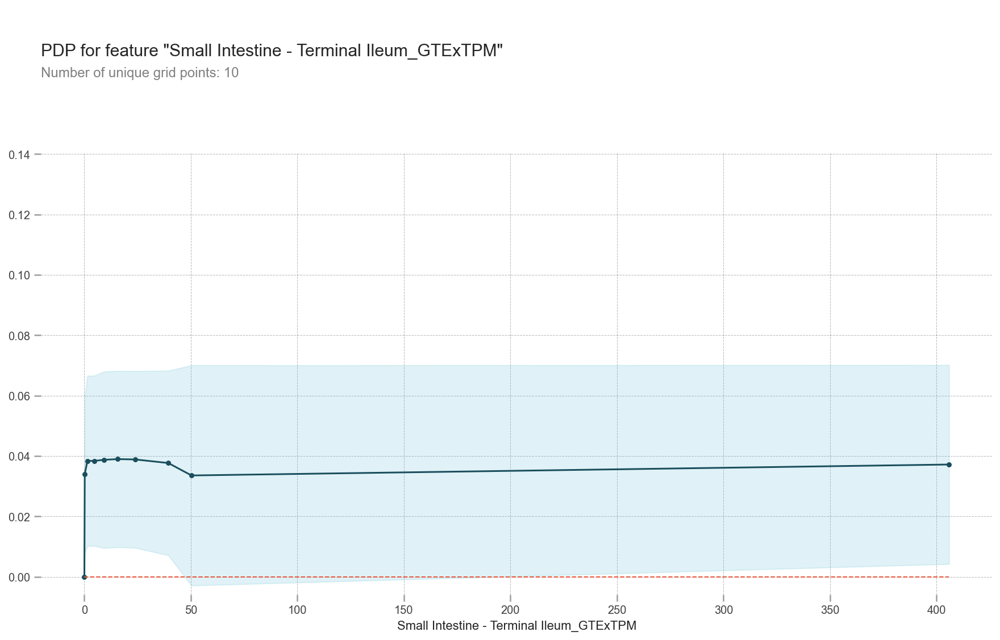

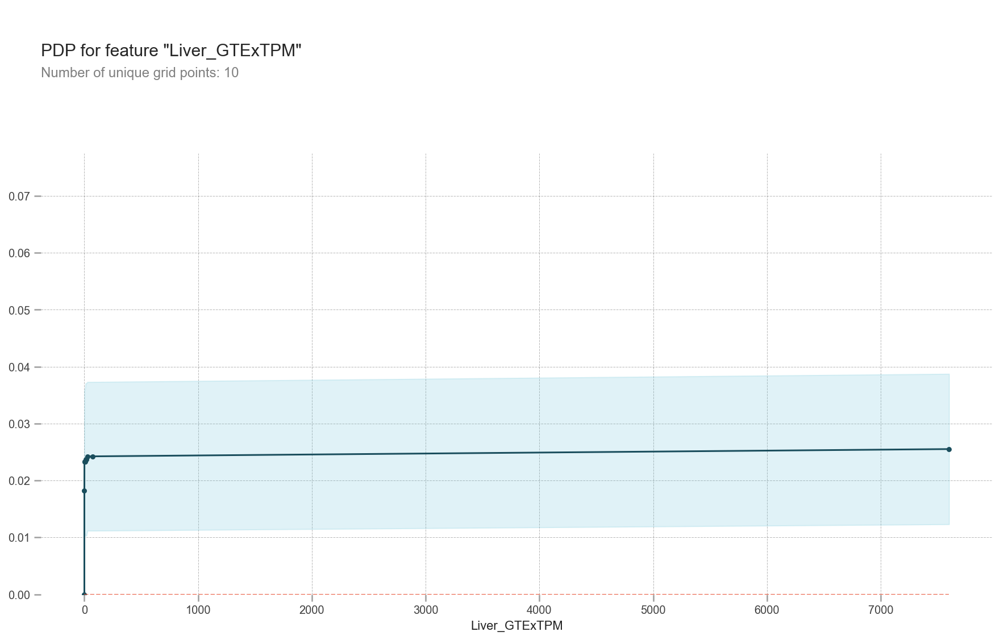

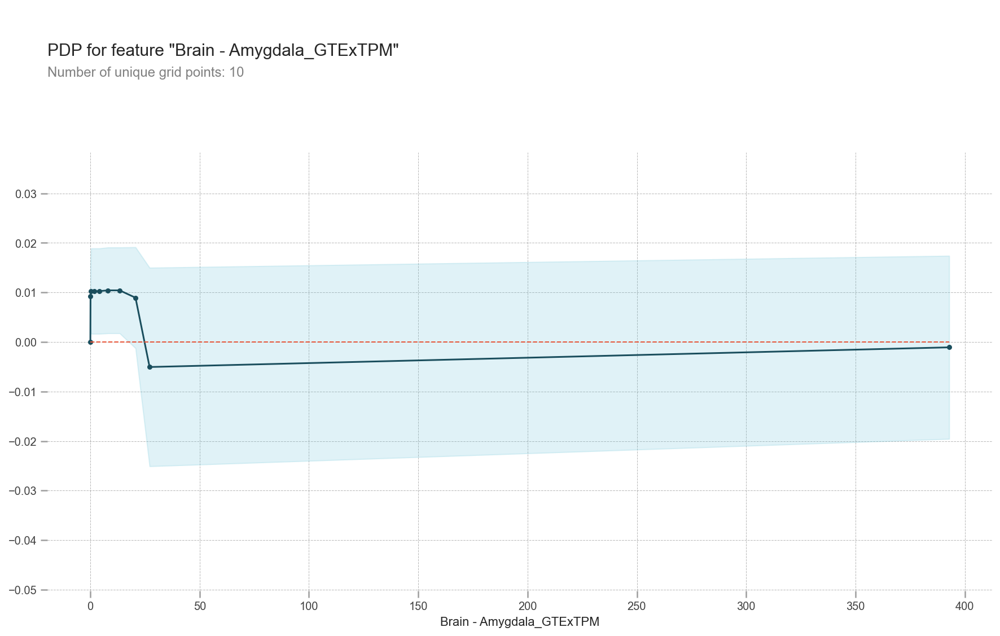

In [53]:
pdp_plotting1('Cells - Cultured fibroblasts_GTExTPM')
pdp_plotting1('Heart - Atrial Appendage_GTExTPM')
pdp_plotting1('Adrenal Gland_GTExTPM')
pdp_plotting1('Testis_GTExTPM')
pdp_plotting1('humanScore_Exomiser')
pdp_plotting1('pLI_ExAC')
pdp_plotting1('GDI_Score')
pdp_plotting1('Lung_GTExTPM')
pdp_plotting1('HIPred')
pdp_plotting1('Whole Blood_GTExTPM')
pdp_plotting1('Ovary_GTExTPM')
pdp_plotting1('Spleen_GTExTPM')
pdp_plotting1('Kidney - Cortex_GTExTPM')
pdp_plotting1('Pituitary_GTExTPM')
pdp_plotting1('Small Intestine - Terminal Ileum_GTExTPM')
pdp_plotting1('Liver_GTExTPM')
pdp_plotting1('Brain - Amygdala_GTExTPM')

In [8]:
def pdp_plotting2(feature1, feature2):
    features_to_plot = [feature1, feature2]
    interaction = pdp.pdp_interact(
    model=tree_model,
    dataset=val_X,
    model_features=X2.columns,
    features=features_to_plot)
    
    pdp.pdp_interact_plot(
    pdp_interact_out=interaction, feature_names=features_to_plot, plot_type="contour")
    plt.show()

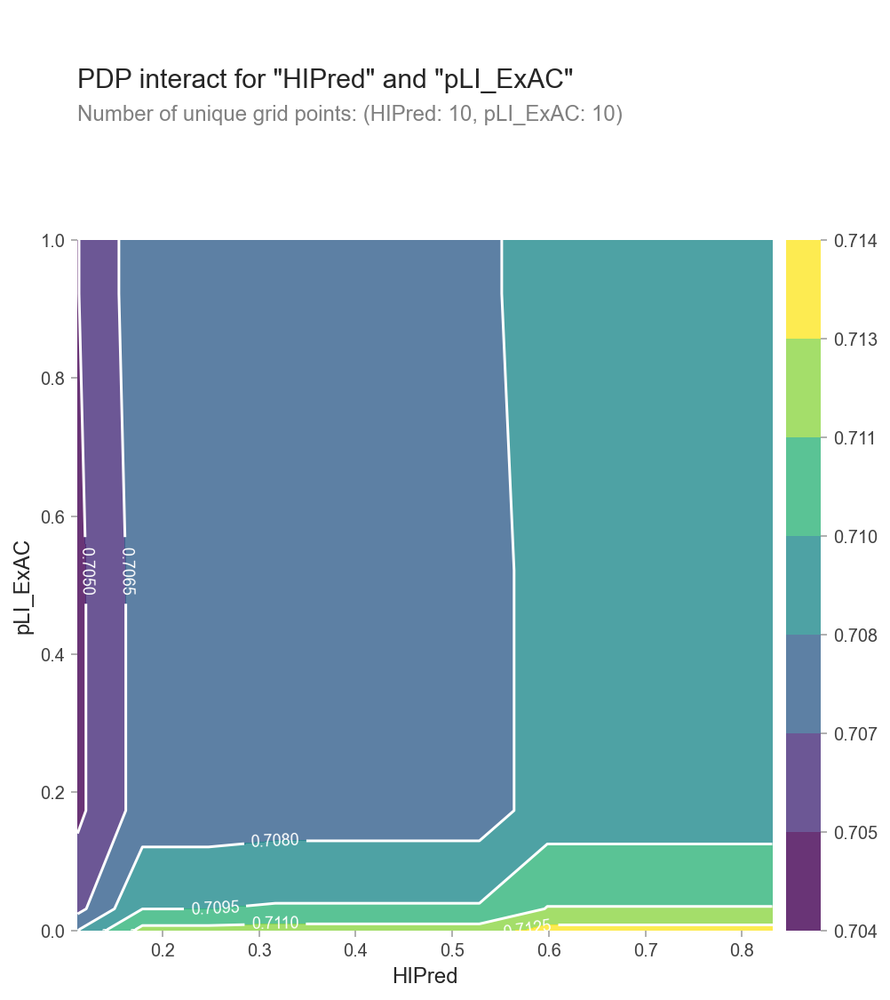

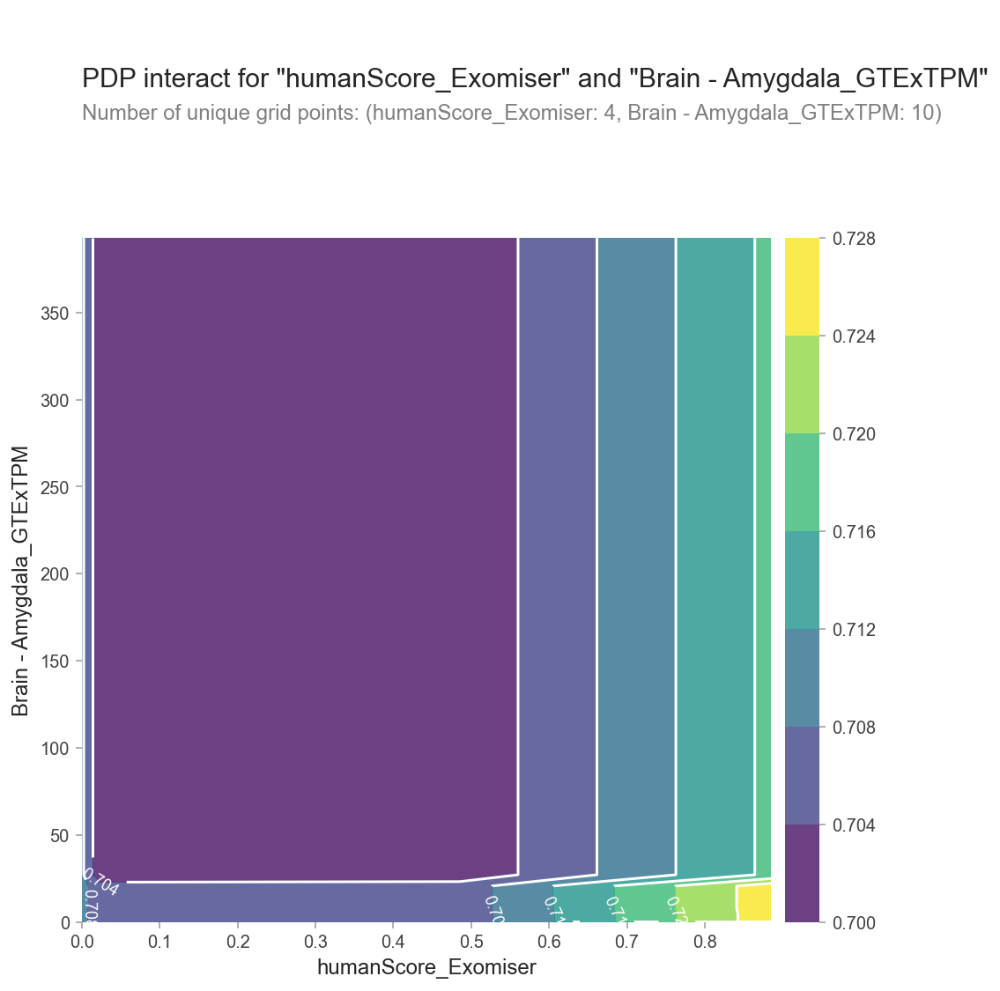

In [9]:
pdp_plotting2("HIPred", "pLI_ExAC")
pdp_plotting2('humanScore_Exomiser', 'Brain - Amygdala_GTExTPM')

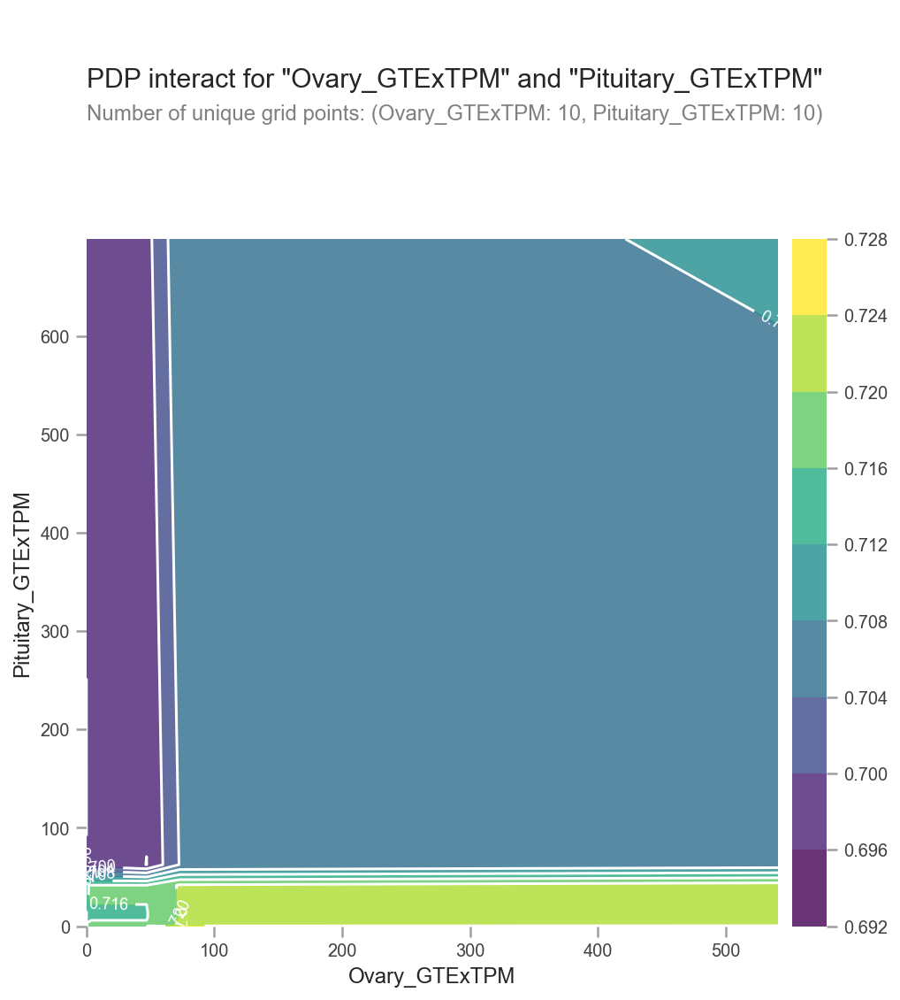

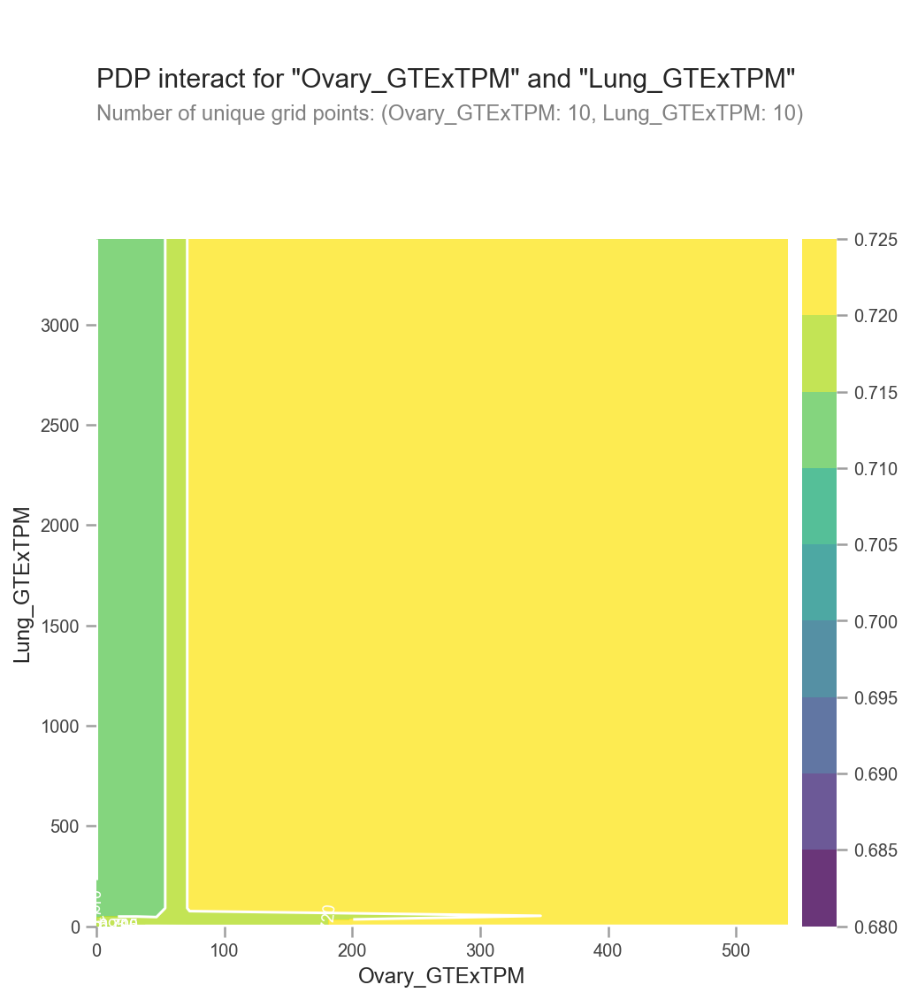

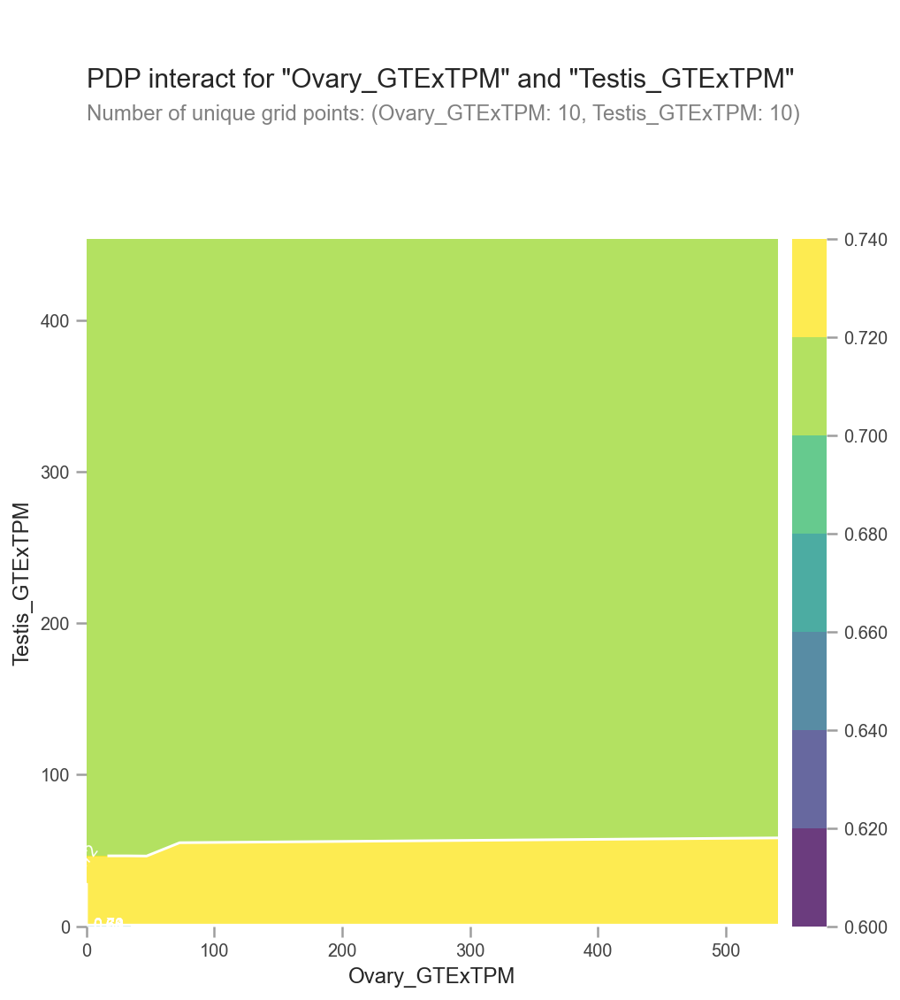

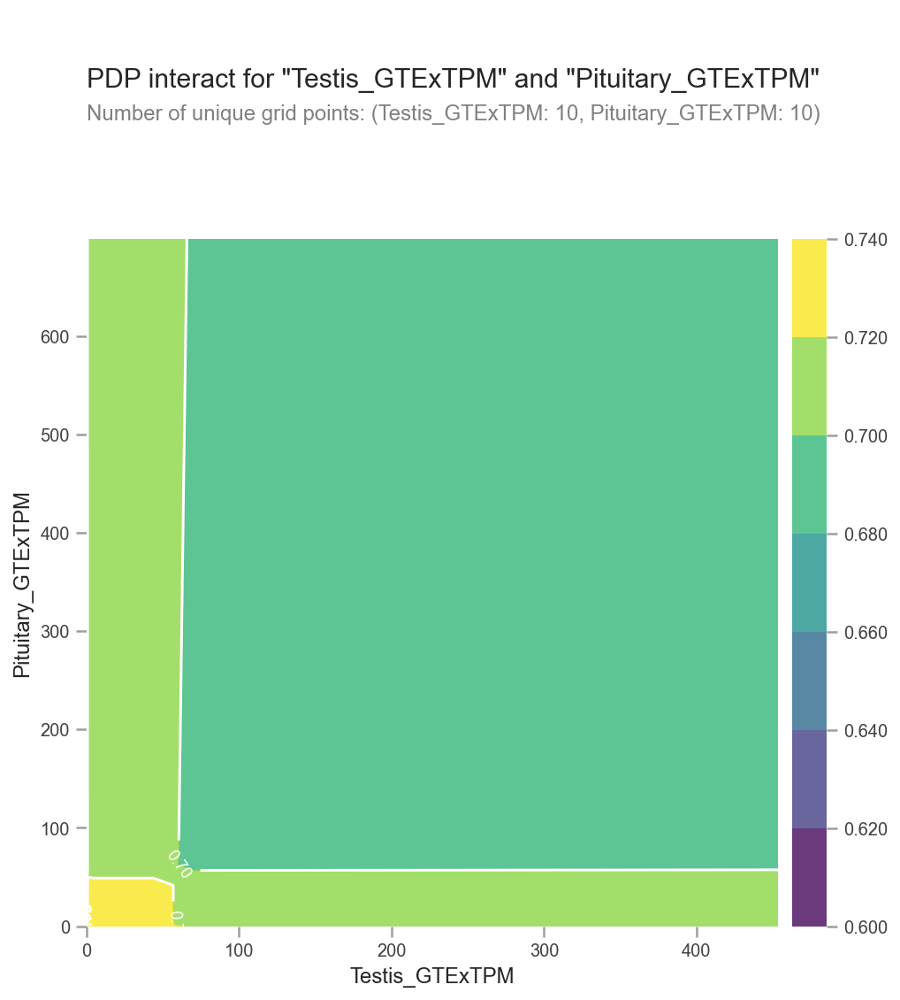

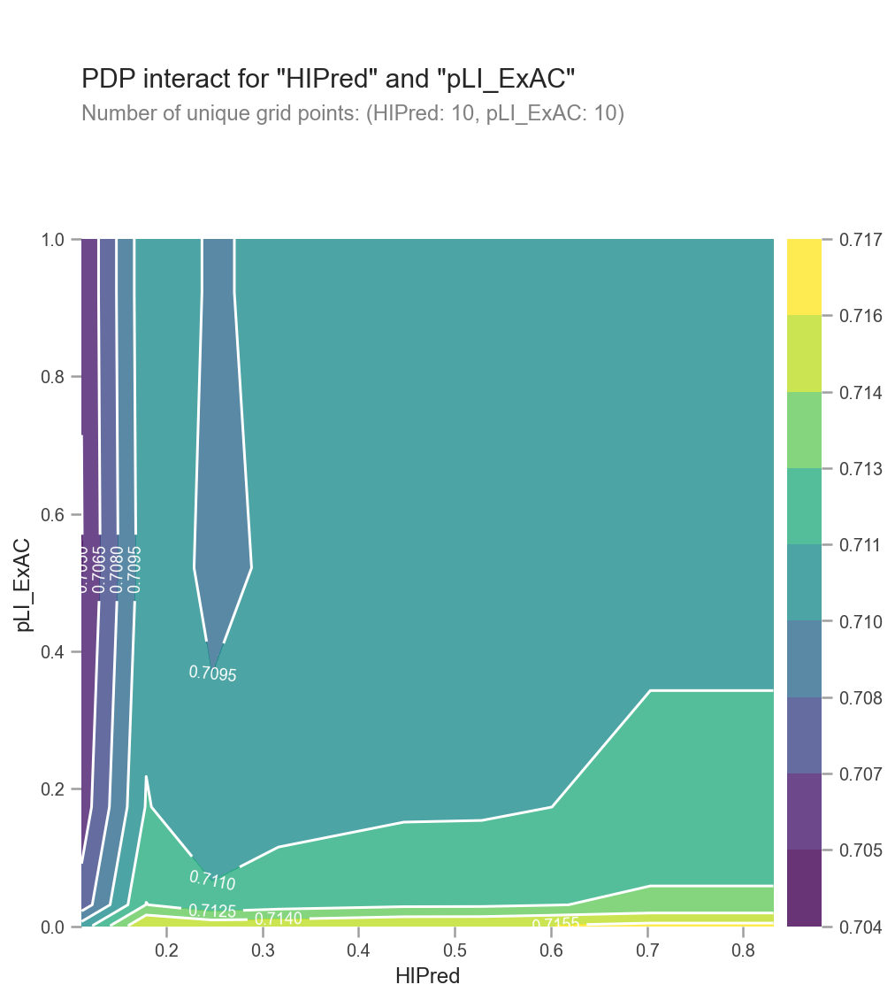

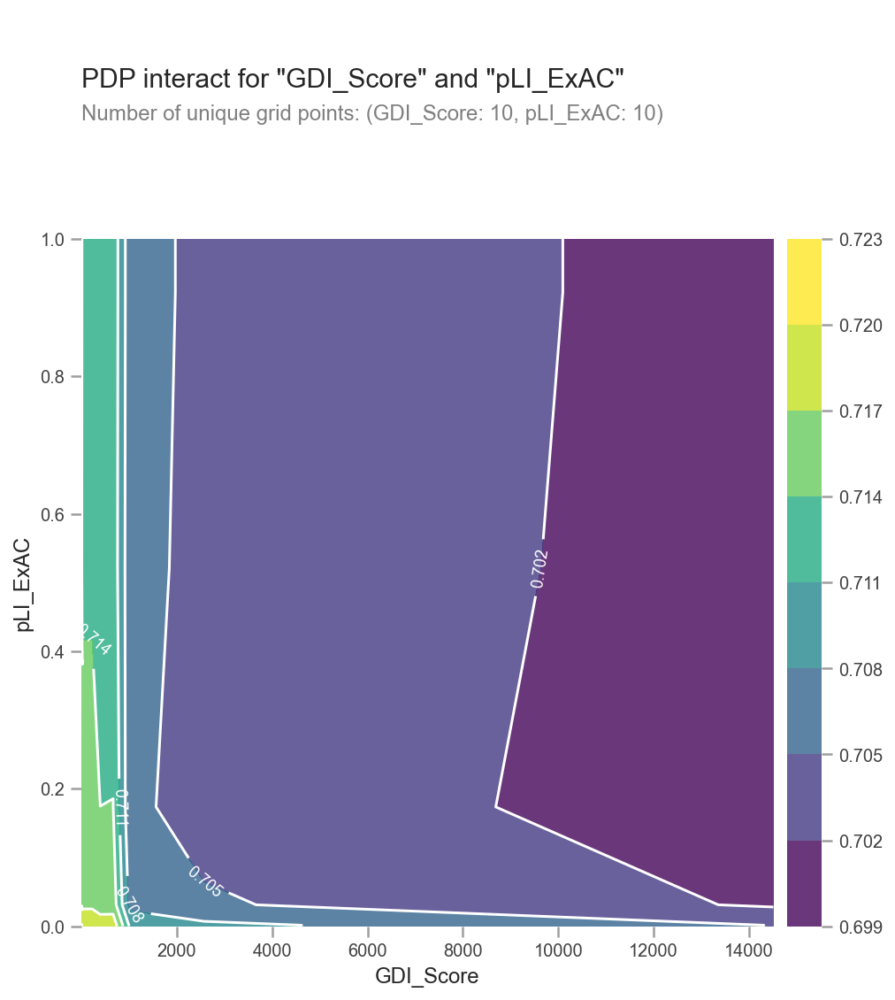

In [55]:
pdp_plotting2('Ovary_GTExTPM', 'Pituitary_GTExTPM')
pdp_plotting2('Ovary_GTExTPM', 'Lung_GTExTPM')
pdp_plotting2('Ovary_GTExTPM', 'Testis_GTExTPM')
pdp_plotting2('Testis_GTExTPM', 'Pituitary_GTExTPM')
pdp_plotting2("HIPred", "pLI_ExAC")
pdp_plotting2("GDI_Score", "pLI_ExAC")

### Clustering to view training data grouping:

#### PCA Explained Variance 
- for deciding n components in hierarchal clustering

In [56]:
mean_vec = np.mean(X2, axis=0)
cov_mat = (X2 - mean_vec).T.dot((X2 - mean_vec)) / (X2.shape[0] - 1)

In [57]:
eig_vals, eig_vecs = np.linalg.eig(cov_mat)

print("Eigenvectors \n%s" % eig_vecs)
print("\nEigenvalues \n%s" % eig_vals)


# Make a list of (eigenvalue, eigenvector) tuples
eig_pairs = [(np.abs(eig_vals[i]), eig_vecs[:, i]) for i in range(len(eig_vals))]

# Sort the (eigenvalue, eigenvector) tuples from high to low
eig_pairs.sort(key=lambda x: x[0], reverse=True)

# Visually confirm that the list is correctly sorted by decreasing eigenvalues
print("Eigenvalues in descending order:")
for i in eig_pairs:
    print(i[0])

Eigenvectors 
[[-6.55102917e-03  3.28090590e-02  4.65799183e-01 -1.58163246e-01
   7.04962799e-01 -4.37880231e-01 -1.94959402e-01 -1.24685867e-01
  -2.08935985e-02  3.27319701e-03  9.45093205e-02  1.02523405e-03
   7.23815442e-02  3.05865609e-03 -1.35069802e-05 -1.00746012e-04
  -8.50642342e-05]
 [-1.89653441e-03  9.17224417e-03  1.06054144e-01 -1.47191157e-02
   3.39070898e-02  2.28992130e-02  2.34474095e-01  3.34650966e-02
  -4.50463818e-02 -1.34508478e-01 -9.70644870e-03 -6.87938259e-01
  -1.79097326e-01 -6.36493899e-01  8.01863108e-04  4.90512823e-05
  -3.30774783e-04]
 [-6.29106903e-03  5.70770407e-02  2.29455494e-01  9.65676944e-01
   1.64318914e-02 -3.82090848e-02 -8.62484343e-02  1.06937998e-02
  -4.51907881e-02  4.31845133e-03 -3.85986496e-04 -7.96786393e-03
  -1.05864767e-02 -1.08515278e-03  6.87818978e-05 -1.07247354e-04
   2.13366377e-05]
 [-2.38942500e-03  1.20389575e-02  7.47740759e-02 -4.52158898e-03
   7.39117670e-02 -8.12136091e-03  2.42861287e-01  1.67918422e-01
  -1.

In [58]:
tot = sum(eig_vals)
var_exp = [(i / tot) * 100 for i in sorted(eig_vals, reverse=True)]
len(var_exp)

17

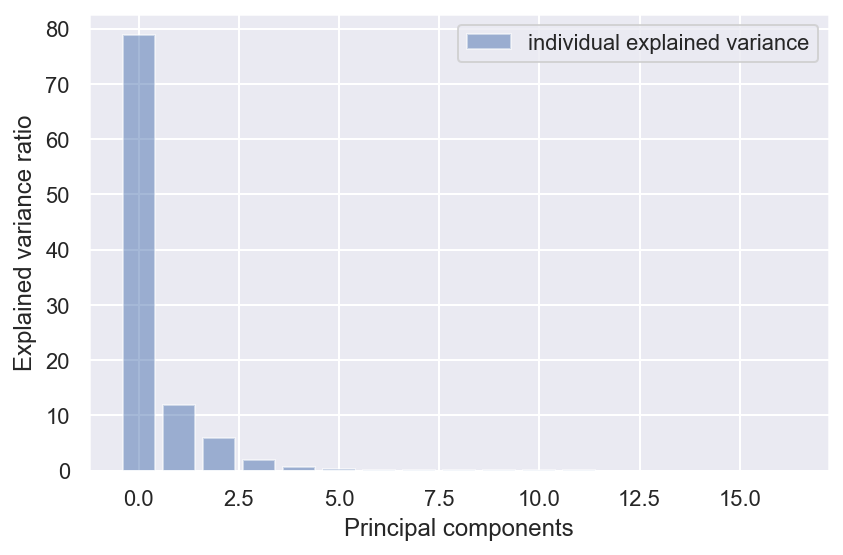

In [60]:
sns.set(font_scale=1)
plt.figure(figsize=(6, 4))

plt.bar(
    range(17), var_exp, alpha=0.5, align="center", label="individual explained variance"
)
plt.ylabel("Explained variance ratio")
plt.xlabel("Principal components")
plt.legend(loc="best")
plt.tight_layout()

Text(0, 0.5, 'Cumulative explained variance')

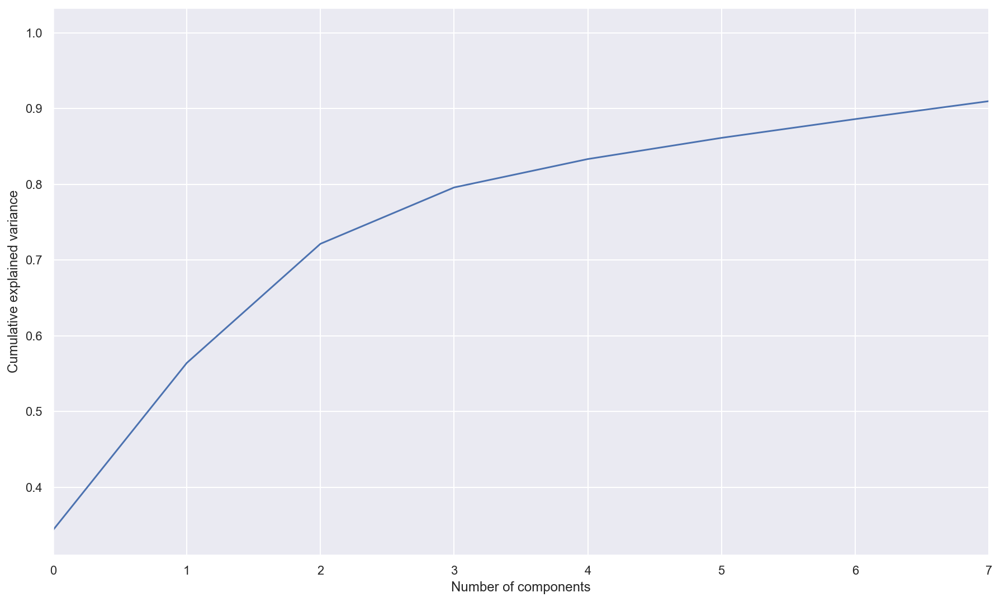

In [61]:
from sklearn.decomposition import PCA

pca = PCA().fit(X)
plt.plot(np.cumsum(pca.explained_variance_ratio_))
plt.xlim(0, 7, 1)
plt.xlabel("Number of components")
plt.ylabel("Cumulative explained variance")

## Hierarchal Clustering

### All training data:

In [62]:
def fancy_dendrogram(*args, **kwargs):
    max_d = kwargs.pop("max_d", None)
    if max_d and "color_threshold" not in kwargs:
        kwargs["color_threshold"] = max_d
    annotate_above = kwargs.pop("annotate_above", 0)
    plt.figure(figsize=(15, 10))
    ddata = dendrogram(*args, **kwargs)

    if not kwargs.get("no_plot", False):
        plt.title("Hierarchical Clustering Dendrogram (truncated)")
        plt.xlabel("sample index or (cluster size)")
        plt.ylabel("distance")
        for i, d, c in zip(ddata["icoord"], ddata["dcoord"], ddata["color_list"]):
            x = 0.5 * sum(i[1:3])
            y = d[1]
            if y > annotate_above:
                plt.plot(x, y, "o", c=c)
                plt.annotate(
                    "%.3g" % y,
                    (x, y),
                    xytext=(0, -5),
                    textcoords="offset points",
                    va="top",
                    ha="center",
                )
        if max_d:
            plt.axhline(y=max_d, c="k")
    return ddata

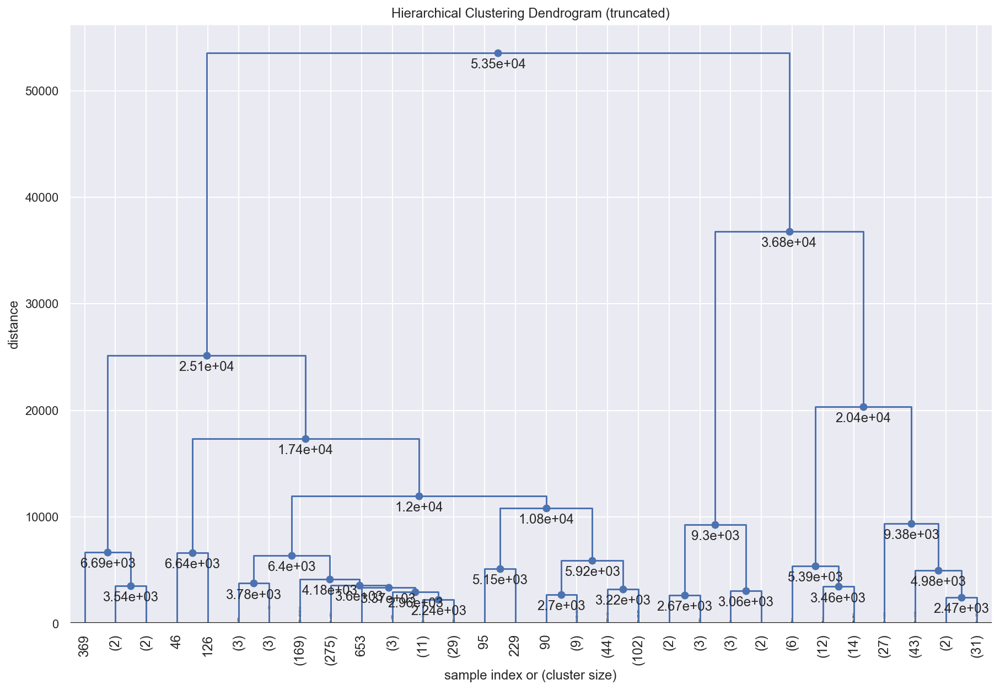

In [63]:
linked_array = ward(X2)

fancy_dendrogram(
    linked_array,
    truncate_mode="lastp",
    p=30,
    leaf_rotation=90.0,
    leaf_font_size=12.0,
    show_contracted=True,
    annotate_above=10,
    max_d=80,
)

plt.show()

In [64]:
# Reducing the dimensions of the data
pca = PCA(n_components=2)
X_principal = pca.fit_transform(X)
X_principal = pd.DataFrame(X_principal)
X_principal.columns = ["P1", "P2"]

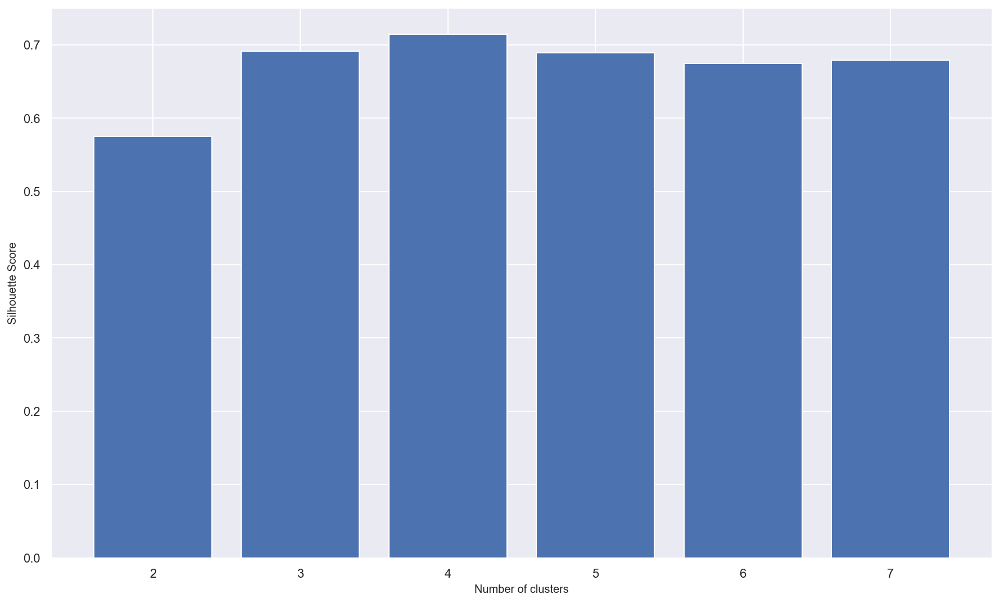

In [65]:
silhouette_scores = []

for n_cluster in range(2, 8):
    silhouette_scores.append(
        silhouette_score(
            X_principal,
            AgglomerativeClustering(n_clusters=n_cluster).fit_predict(X_principal),
        )
    )

# Plotting a bar graph to compare the results
k = [2, 3, 4, 5, 6, 7]
plt.bar(k, silhouette_scores)
plt.xlabel("Number of clusters", fontsize=10)
plt.ylabel("Silhouette Score", fontsize=10)
plt.show()

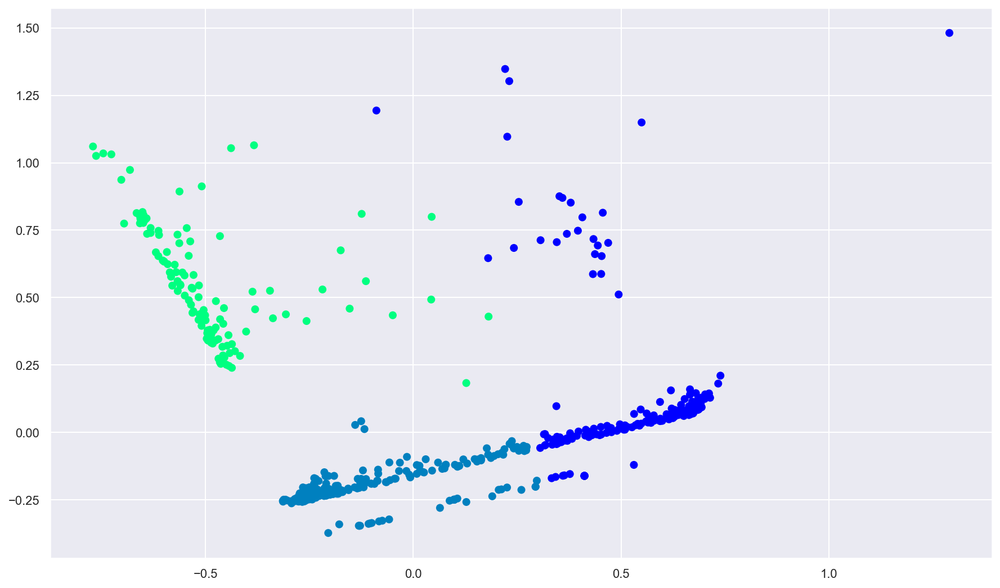

In [67]:
agg = AgglomerativeClustering(n_clusters=3)
agg.fit(X_principal)

sns.set(font_scale=1)
plt.scatter(
    X_principal["P1"],
    X_principal["P2"],
    c=AgglomerativeClustering(n_clusters=3).fit_predict(X_principal),
    cmap=plt.cm.winter,
)
plt.show()

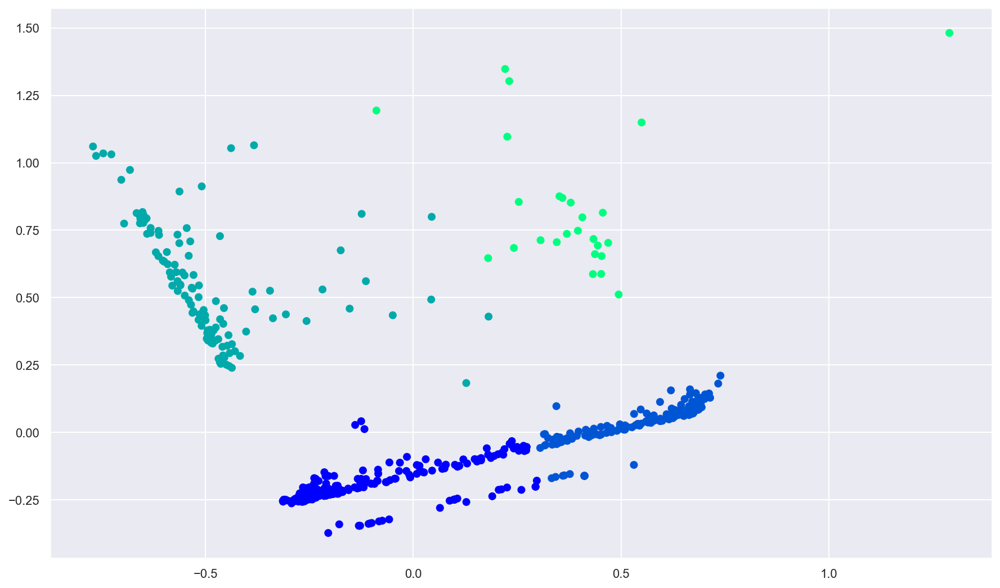

In [68]:
agg = AgglomerativeClustering(n_clusters=4)
agg.fit(X_principal)

sns.set(font_scale=1)
plt.scatter(
    X_principal["P1"],
    X_principal["P2"],
    c=AgglomerativeClustering(n_clusters=4).fit_predict(X_principal),
    cmap=plt.cm.winter,
)
plt.show()

### Elbow and silhouette scores - no PCA

Text(0, 0.5, 'Total within-cluster sum of squares')

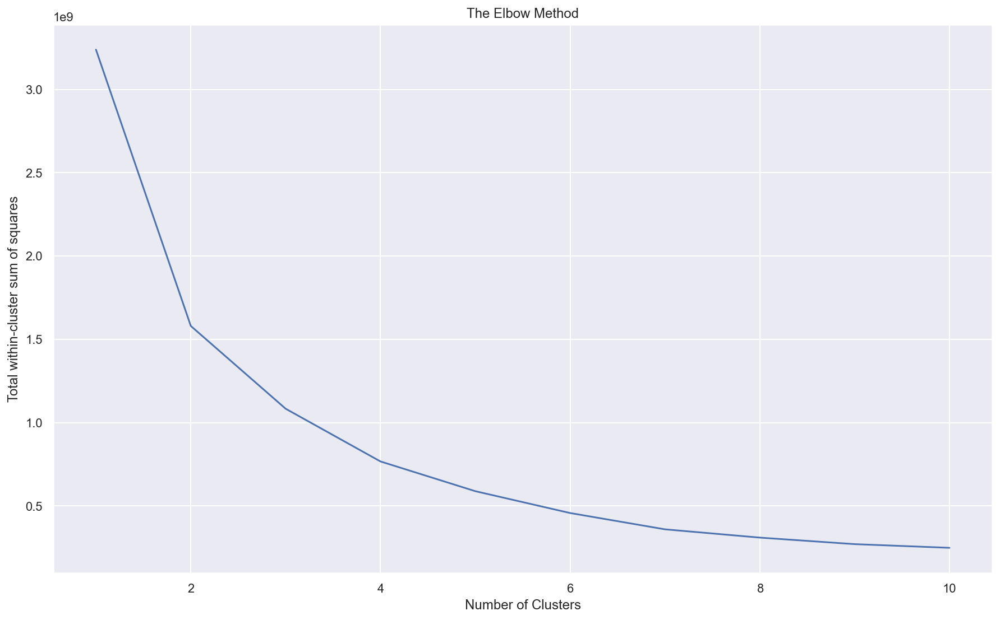

In [69]:
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_samples, silhouette_score

twss = []
sa = []
for i in range(1, 11):
    kmeans = KMeans(n_clusters=i, init="k-means++")
    kmeans.fit(X2)
    Ypreds = kmeans.predict(X2)
    twss.append(kmeans.inertia_)
    if i > 1:
        sa.append(silhouette_score(X2, Ypreds))


plt.plot(range(1, 11), twss)
plt.title("The Elbow Method")
plt.xlabel("Number of Clusters")
plt.ylabel("Total within-cluster sum of squares")

Text(0, 0.5, 'Average silhouette score')

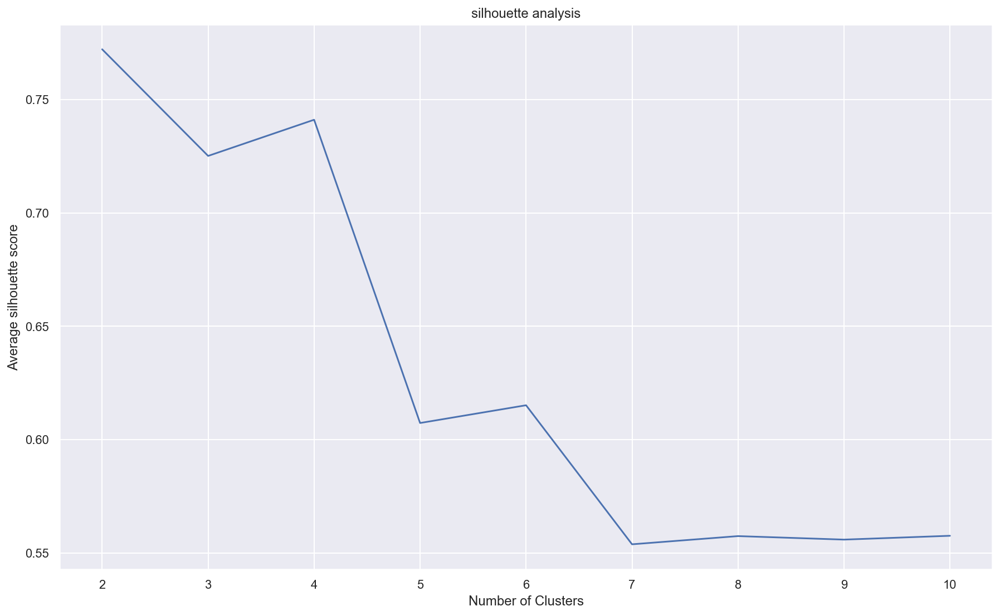

In [70]:
plt.plot(range(2, 11), sa)
plt.title("silhouette analysis")
plt.xlabel("Number of Clusters")
plt.ylabel("Average silhouette score")